### Final annotation of Mesenchymal cells (adult/paediatric)


Preprocessing:
- mesenchymal cells from main object subsetted, then subsetted cells from adult/paediatric patients
- performed scvi batch correction to prepare objects

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.5 scikit-learn==0.24.1 statsmodels==0.13.5 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.2


In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/post_scvi20221124/Mes_AP.hvg5000_noCC.scvi_output.with_annotv2.22021124.h5ad')

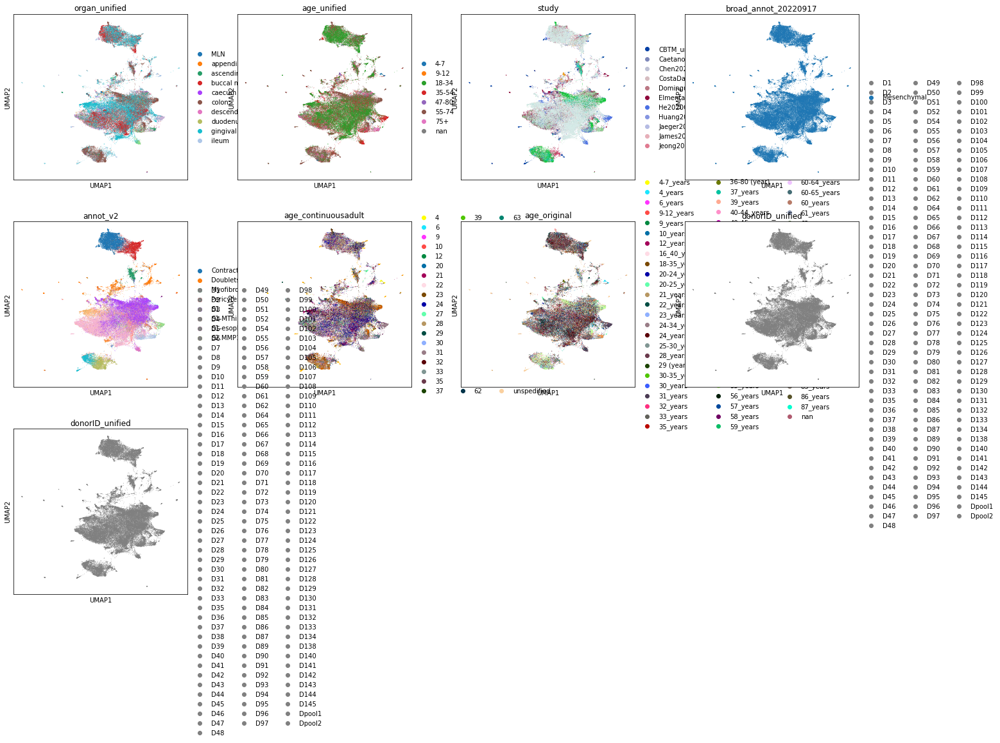

In [4]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata, color=['organ_unified', 'age_unified','study','broad_annot_20220917','annot_v2','age_continuousadult','age_original','donorID_unified','donorID_unified'],cmap='OrRd')

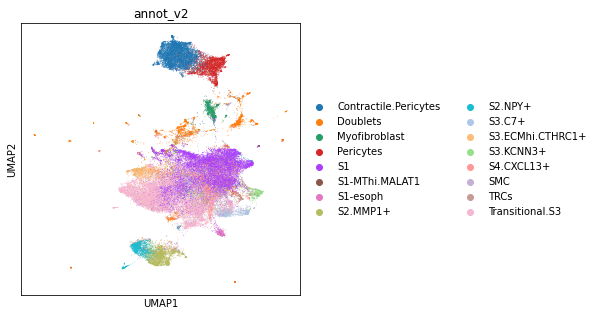

In [5]:
sc.pl.umap(adata,color='annot_v2')

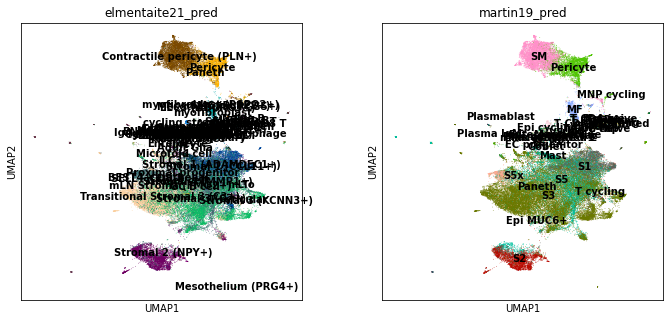

In [6]:
sc.pl.umap(adata, color=['elmentaite21_pred','martin19_pred'],legend_loc='on data')

In [23]:
pd.set_option('display.max_rows', 500)
adata.obs.elmentaite21_pred.value_counts()

Stromal 3 (C7+)                 12138
Transitional Stromal 3 (C3+)    11395
Stromal 4 (MMP1+)                8486
Stromal 1 (CCL11+)               7348
Stromal 2 (NPY+)                 7278
Contractile pericyte (PLN+)      7107
Pericyte                         3645
Stromal 1 (ADAMDEC1+)            1915
IgA plasma cell                  1215
myofibroblast                    1027
Microfold cell                    789
TA                                419
T reticular                       247
mLN Stroma (FMO2+)                221
Mesoderm 1 (HAND1+)               165
SMC (PLPP2+)                      148
myofibroblast (RSPO2+)            147
FDC                               129
Enterocyte                        128
cycling stromal                   121
Activated CD4 T                    95
Mesothelium                        81
Memory B                           63
Adult Glia                         61
Mature venous EC                   60
SELL+ CD4 T                        55
Stromal 3 (K

In [22]:
adata.obs.martin19_pred.value_counts()

S3                  27709
S5                   9420
SM                   6761
S1                   6554
Pericyte             4406
S2                   4143
S5x                  1881
MF                   1494
EC progenitor        1047
Plasma IgM            382
Epi cycling           274
EC                    148
Epi MUC6+              87
B mem                  64
Paneth                 55
B cycling              51
VE cap                 48
Glial                  45
T cycling              40
T CD4 naive            37
B naive                33
VE art                 32
T reg                  29
T CD8 exhausted        26
aDC                    25
Plasma IgG             24
T CD4                  24
rMac activated 1       20
T CD8 naive            18
Mast                   18
VE ven                 17
Goblet                 17
T CD8 mem              15
Plasmablast            14
MNP cycling            11
rMac activated 2       10
VE tip                  9
LE                      7
ILC         

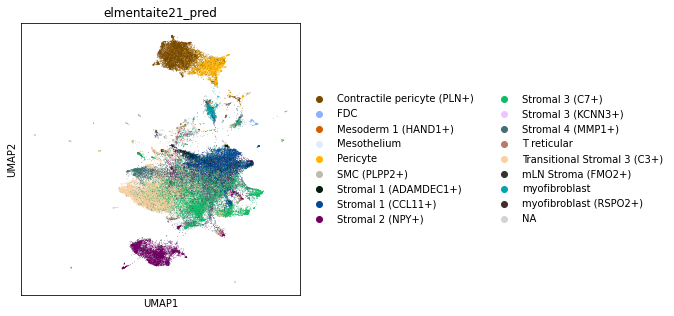

In [24]:
sc.pl.umap(adata,color='elmentaite21_pred',groups=['Stromal 3 (C7+)',
'Transitional Stromal 3 (C3+)',
'Stromal 4 (MMP1+)',
'Stromal 1 (CCL11+)',
'Stromal 2 (NPY+)',
'Contractile pericyte (PLN+)',
'Pericyte',
'Stromal 1 (ADAMDEC1+)',
'myofibroblast',
'T reticular',
'mLN Stroma (FMO2+)',
'Mesoderm 1 (HAND1+)',
'SMC (PLPP2+)',
'myofibroblast (RSPO2+)',
'FDC',
'Mesothelium',
'Stromal 3 (KCNN3+)'])

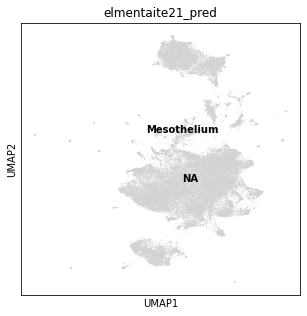

In [140]:
sc.pl.umap(adata,color='elmentaite21_pred',groups=[
'Mesothelium'],legend_loc = 'on data')

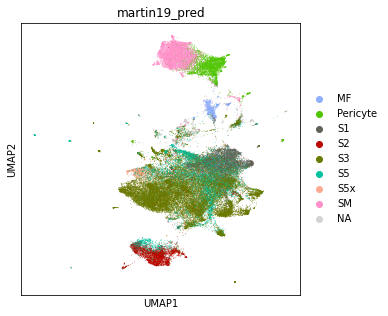

In [25]:
sc.pl.umap(adata,color='martin19_pred',groups=['S3',
'S5',
'SM',
'S1',
'Pericyte',
'S2',
'S5x',
'MF'])

In [7]:
adata.X.max()

15077.0

In [8]:
#save raw counts in layers
adata.layers['counts'] = adata.X
#normalise and transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

In [9]:
adata.X.max()

8.852832

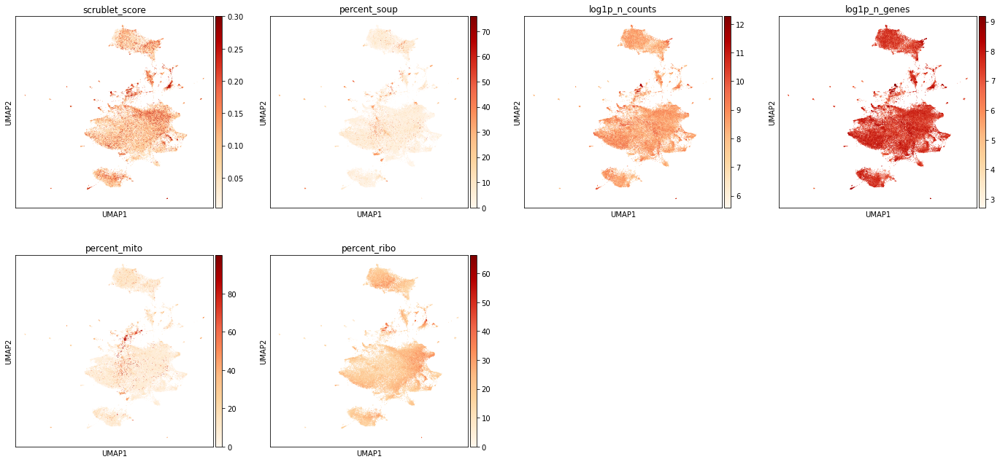

In [10]:
#plot some basic QC
sc.pl.umap(adata, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

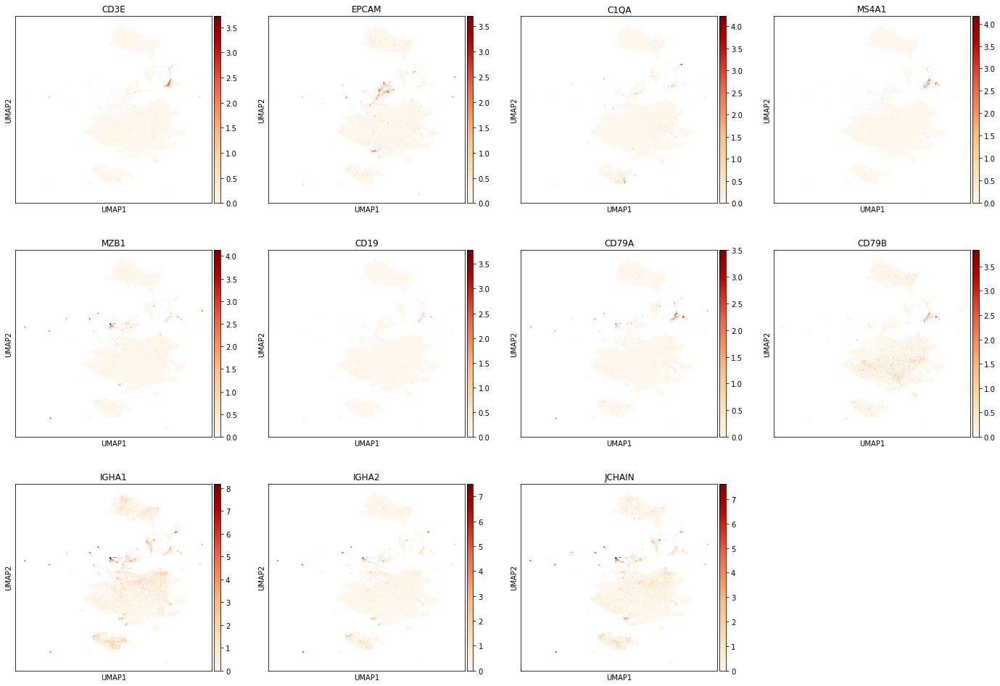

In [12]:
#plot doublet genes
sc.pl.umap(adata, color = ['CD3E','EPCAM','C1QA','MS4A1','MZB1','CD19','CD79A','CD79B','IGHA1','IGHA2','JCHAIN'],cmap='OrRd')

In [13]:
#score cell cycle genes
cell_cycle_genes = ['MCM5',
'PCNA',
 'TYMS',
 'FEN1',
 'MCM2',
 'MCM4',
 'RRM1',
 'UNG',
 'GINS2',
 'MCM6',
 'CDCA7',
 'DTL',
 'PRIM1',
 'UHRF1',
 'MLF1IP',
 'HELLS',
 'RFC2',
 'RPA2',
 'NASP',
 'RAD51AP1',
 'GMNN',
 'WDR76',
 'SLBP',
 'CCNE2',
 'UBR7',
 'POLD3',
 'MSH2',
 'ATAD2',
 'RAD51',
 'RRM2',
 'CDC45',
 'CDC6',
 'EXO1',
 'TIPIN',
 'DSCC1',
 'BLM',
 'CASP8AP2',
 'USP1',
 'CLSPN',
 'POLA1',
 'CHAF1B',
 'BRIP1',
 'E2F8',
 'HMGB2',
 'CDK1',
 'NUSAP1',
 'UBE2C',
 'BIRC5',
 'TPX2',
 'TOP2A',
 'NDC80',
 'CKS2',
 'NUF2',
 'CKS1B',
 'MKI67',
 'TMPO',
 'CENPF',
 'TACC3',
 'FAM64A',
 'SMC4',
 'CCNB2',
 'CKAP2L',
 'CKAP2',
 'AURKB',
 'BUB1',
 'KIF11',
 'ANP32E',
 'TUBB4B',
 'GTSE1',
 'KIF20B',
 'HJURP',
 'CDCA3',
 'HN1',
 'CDC20',
 'TTK',
 'CDC25C',
 'KIF2C',
 'RANGAP1',
 'NCAPD2',
 'DLGAP5',
 'CDCA2',
 'CDCA8',
 'ECT2',
 'KIF23',
 'HMMR',
 'AURKA',
 'PSRC1',
 'ANLN',
 'LBR',
 'CKAP5',
 'CENPE',
 'CTCF',
 'NEK2',
 'G2E3',
 'GAS2L3',
 'CBX5',
 'CENPA']

In [14]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)
adata = adata[adata.obs.G2M_score.sort_values(ascending=True).index].copy()

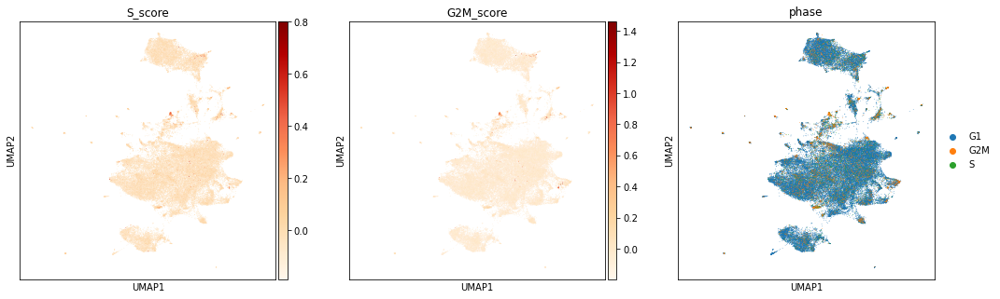

In [15]:
sc.pl.umap(adata,color=['S_score', 'G2M_score', 'phase'],cmap='OrRd')

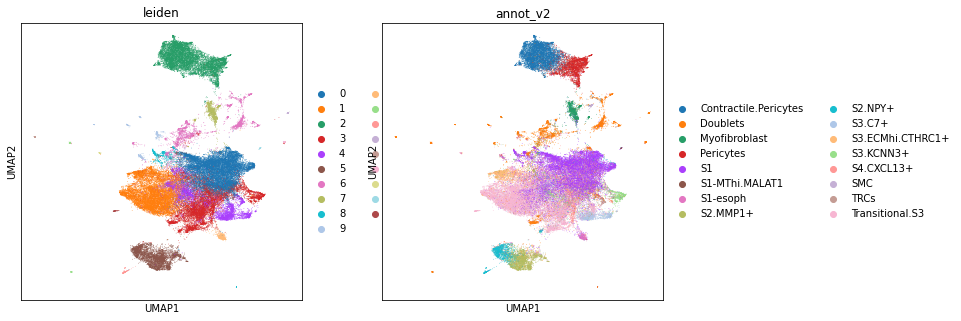

In [16]:
sc.tl.leiden(adata, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(adata,color=['leiden','annot_v2'])

In [27]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *

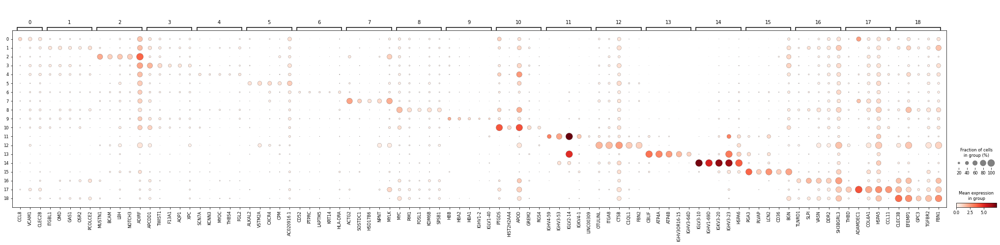

In [18]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden', mks=mks)

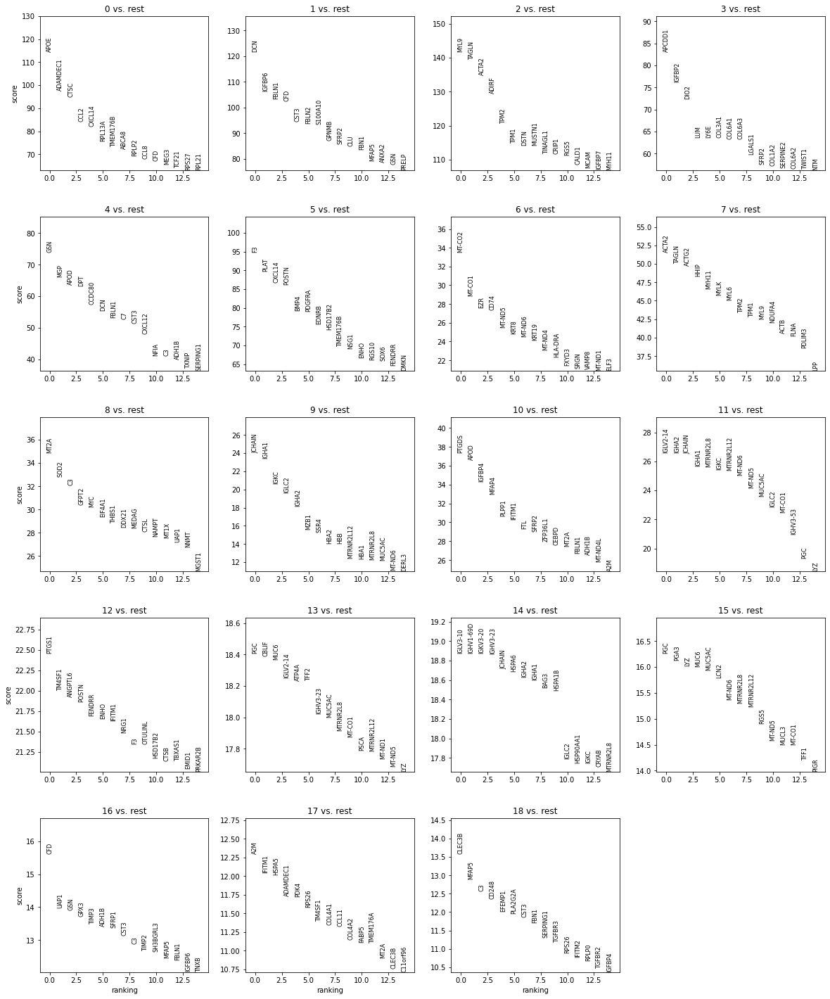

In [19]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False)

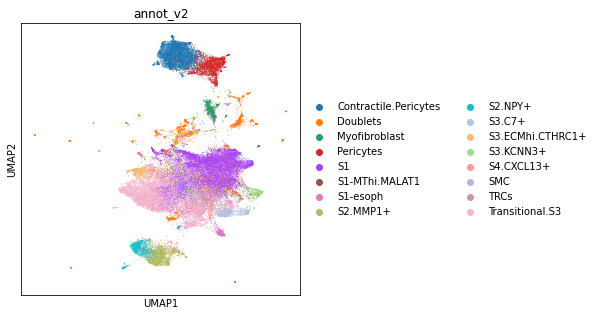

In [26]:
sc.pl.umap(adata,color=['annot_v2'],cmap='OrRd')

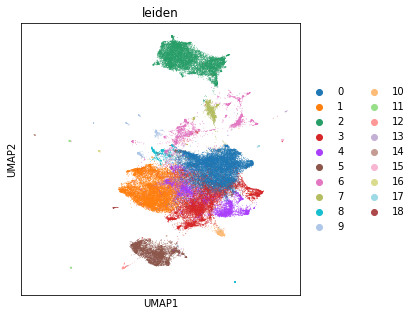

In [27]:
sc.pl.umap(adata,color='leiden')

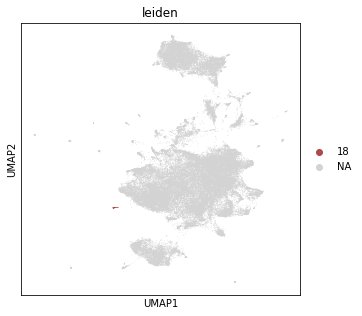

In [43]:
sc.pl.umap(adata,color='leiden',groups='18')

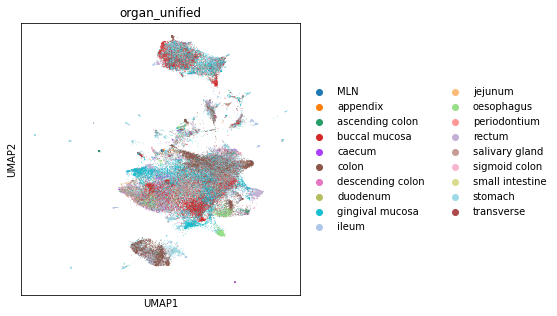

In [38]:
sc.pl.umap(adata,color='organ_unified')

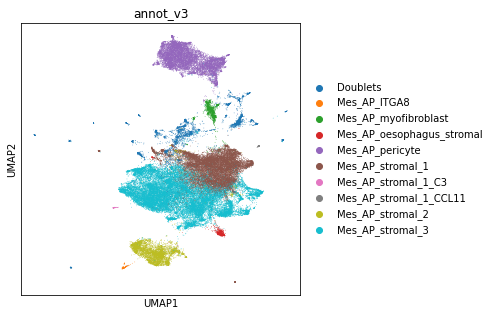

In [45]:
new_cluster_names = [
    'Mes_AP_stromal_1','Mes_AP_stromal_3', #0,1
    'Mes_AP_pericyte','Mes_AP_stromal_3', #2,3
    'Mes_AP_stromal_3','Mes_AP_stromal_2', #4,5
    'Doublets','Mes_AP_myofibroblast', #6,7 
   'Mes_AP_stromal_1','Doublets',#8,9
    'Mes_AP_oesophagus_stromal','Doublets',#10,11
    'Mes_AP_ITGA8','Doublets',#12,13
    'Doublets','Doublets',#14,15
    'Mes_AP_stromal_1','Mes_AP_stromal_1_CCL11',#16,17
    'Mes_AP_stromal_1_C3'


]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

adata.obs['annot_v3'] = [conv[x] for x in adata.obs['leiden']]
sc.pl.umap(adata,color='annot_v3')

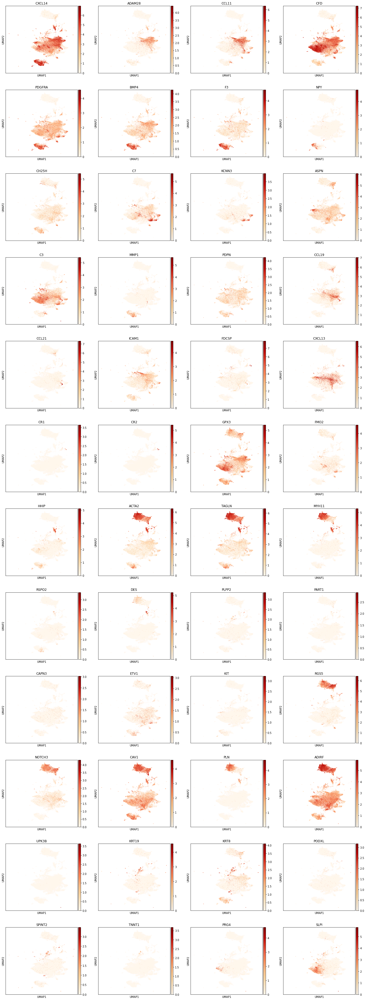

In [41]:
sc.pl.umap(adata,color=['CXCL14','ADAM28','CCL11','CFD', #stromal 1
                        'PDGFRA','BMP4','F3','NPY','CH25H', #stromal 2
                        'C7','KCNN3','ASPN','C3', #stromal 3
                       'MMP1','PDPN', #stromal 4
                       'CCL19','CCL21','ICAM1', #mLTo/FRC
                        'FDCSP','CXCL13','CR1','CR2',
                        'GPX3','FMO2', #mLN stroma
                        'HHIP','ACTA2','TAGLN','MYH11','RSPO2', #myofibro and RSPO2 myofibro
                        'DES','PLPP2','PART1','CAPN3', #SMC
                        'ETV1','KIT', #ICC
                        'RGS5','NOTCH3','CAV1','PLN','ADIRF',#pericyte
                        'UPK3B','KRT19','KRT8','PODXL','SPINT2','TNNT1','PRG4',#mesothelium
                        'SLPI'
                       ],cmap='OrRd')

need to separate pericytes and extract lymph node fibroblasts

In [46]:
peri = adata[adata.obs.annot_v3.isin(['Mes_AP_pericyte'])].copy()

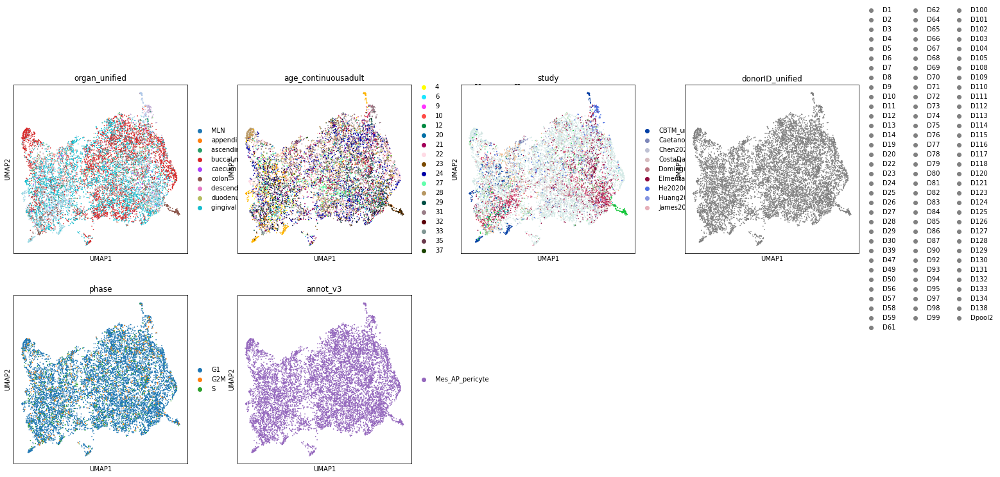

In [47]:
sc.pp.neighbors(
        peri,
            use_rep="X_scvi",
            n_pcs=peri.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(peri, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(peri, color=['organ_unified', 'age_continuousadult','study','donorID_unified','phase','annot_v3'])

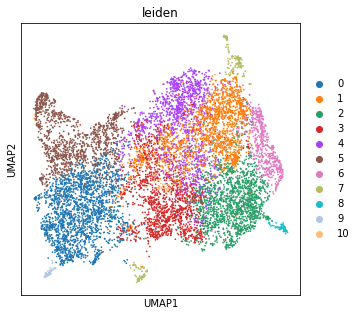

In [68]:
sc.tl.leiden(peri, resolution = 0.6, neighbors_key="neighbors_scvi")
sc.pl.umap(peri, color=['leiden'])

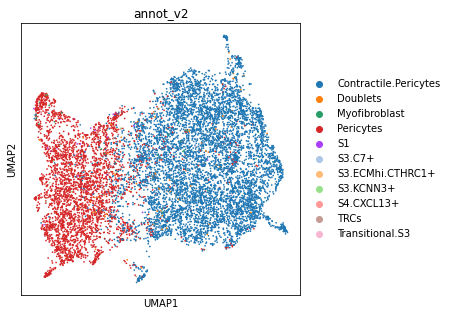

In [54]:
sc.pl.umap(peri,color='annot_v2')

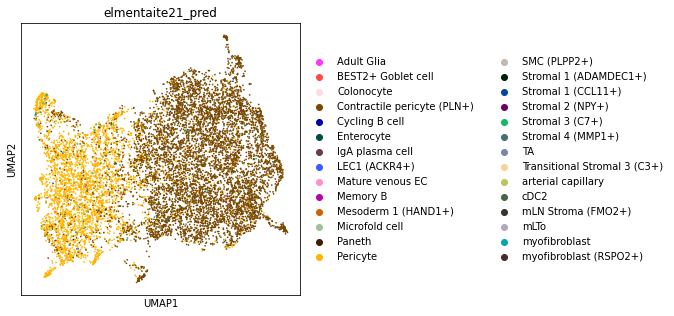

In [56]:
sc.pl.umap(peri,color='elmentaite21_pred')

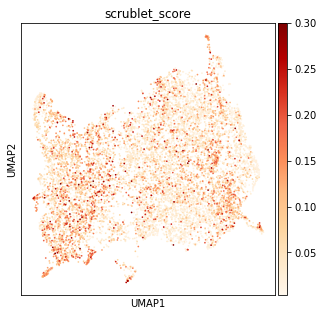

In [58]:
sc.pl.umap(peri,color='scrublet_score',cmap='OrRd')

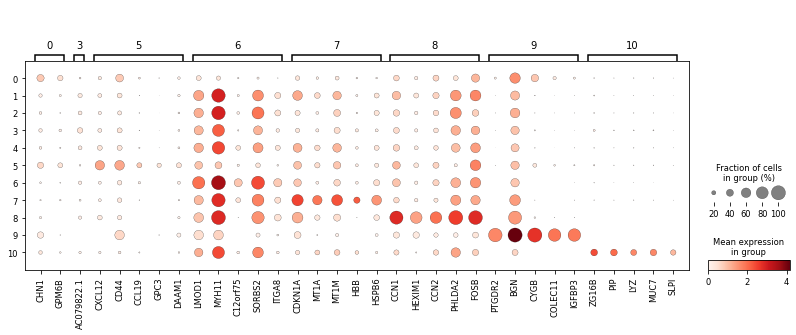

In [53]:
peri.raw = peri.copy()
mkst = calc_marker_stats(peri, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(peri, groupby='leiden', mks=mks)

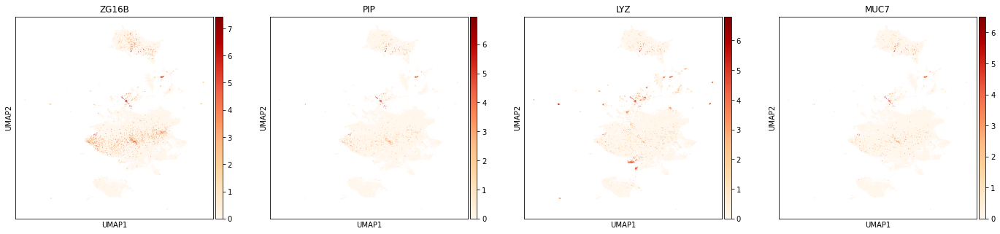

In [65]:
sc.pl.umap(adata,color=['ZG16B','PIP','LYZ','MUC7'],cmap='OrRd')

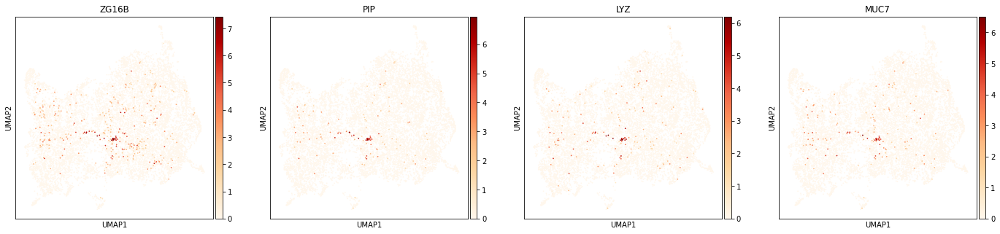

In [66]:
sc.pl.umap(peri,color=['ZG16B','PIP','LYZ','MUC7'],cmap='OrRd')

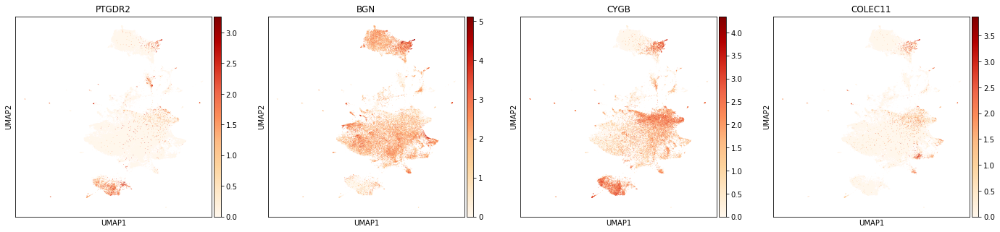

In [63]:
sc.pl.umap(adata,color=['PTGDR2','BGN','CYGB','COLEC11'],cmap='OrRd')

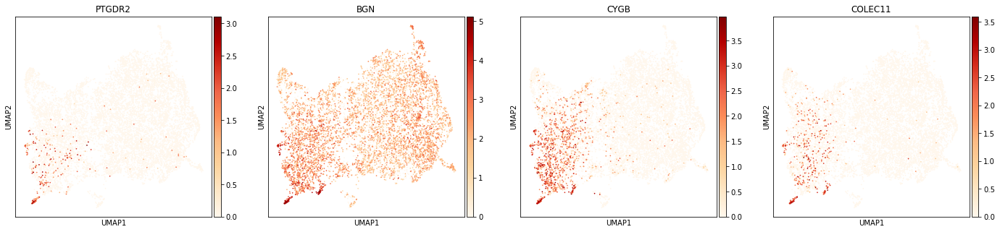

In [64]:
sc.pl.umap(peri,color=['PTGDR2','BGN','CYGB','COLEC11'],cmap='OrRd')

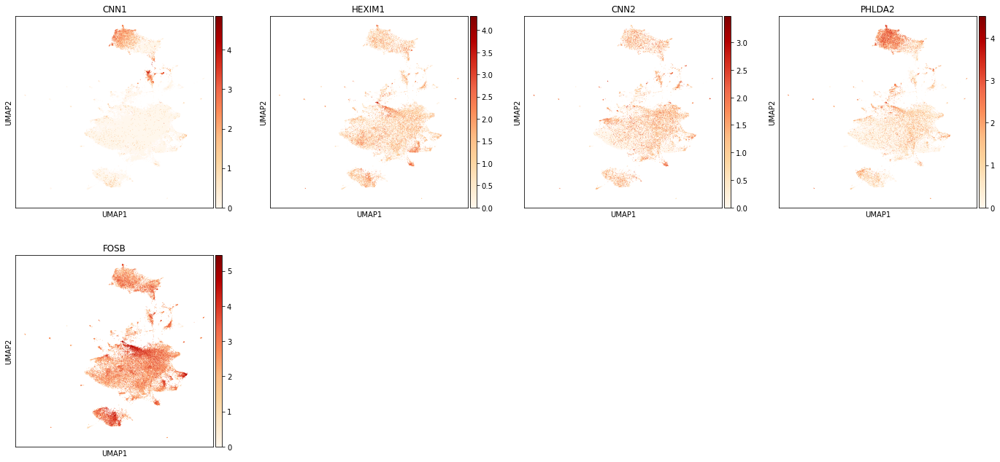

In [60]:
sc.pl.umap(adata,color=['CNN1','HEXIM1','CNN2','PHLDA2','FOSB'],cmap='OrRd')

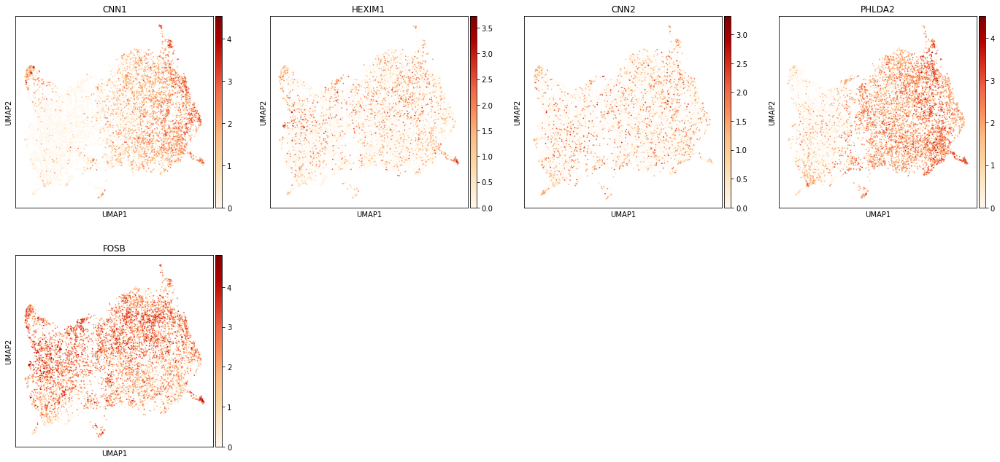

In [61]:
sc.pl.umap(peri,color=['CNN1','HEXIM1','CNN2','PHLDA2','FOSB'],cmap='OrRd')

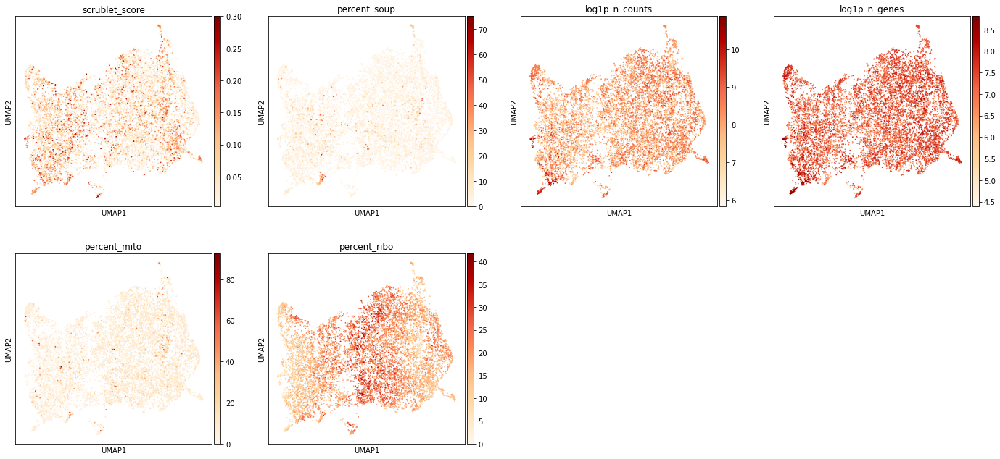

In [62]:
#plot some basic QC
sc.pl.umap(peri, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

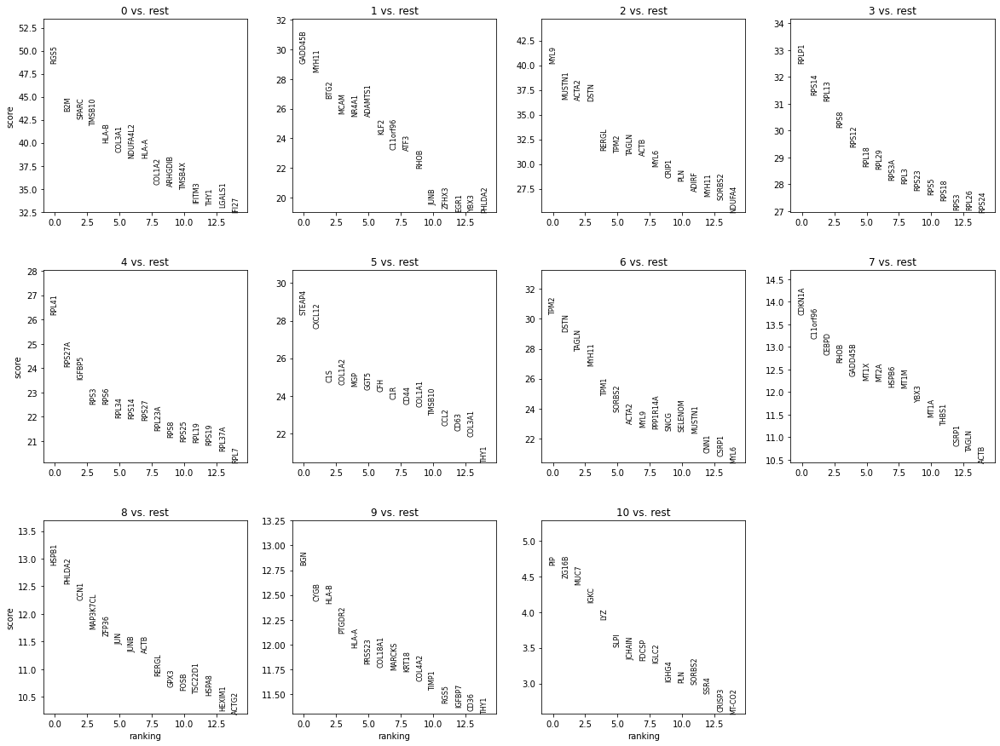

In [55]:
sc.tl.rank_genes_groups(peri, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(peri, n_genes=15, sharey=False)

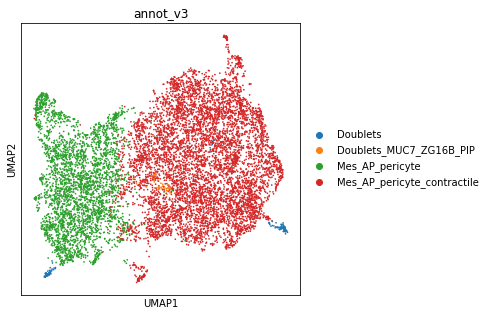

In [69]:
new_cluster_names = [
    'Mes_AP_pericyte','Mes_AP_pericyte_contractile', #0,1
    'Mes_AP_pericyte_contractile','Mes_AP_pericyte_contractile',#2,3
    'Mes_AP_pericyte_contractile','Mes_AP_pericyte',#4,5
    'Mes_AP_pericyte_contractile','Mes_AP_pericyte_contractile',#6,7
    'Doublets','Doublets',#8,9
    'Doublets_MUC7_ZG16B_PIP'#10

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

peri.obs['annot_v3'] = [conv[x] for x in peri.obs['leiden']]
sc.pl.umap(peri,color='annot_v3')

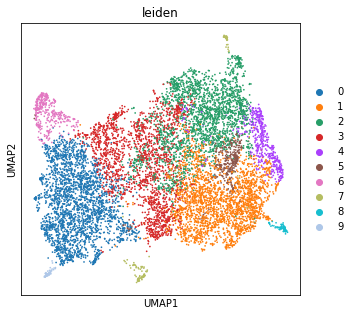

In [70]:
#doublets with high MT and Hemoglobin genes - annotate cluster 7 as doublets
sc.tl.leiden(peri, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(peri, color=['leiden'])

In [71]:
peri_7 = peri[peri.obs.leiden.isin(['7'])].copy()

In [72]:
peri_7.obs['annot_v3'] = (
    peri_7.obs["leiden"]
    .map(lambda x: {'7':'Doublets'}.get(x, x))
    .astype("category")
)

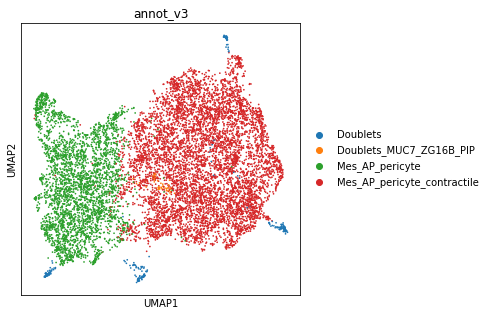

In [73]:
ON = {O:N for O,N in zip(peri_7.obs_names,peri_7.obs["annot_v3"])}
peri.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(peri.obs_names, peri.obs["annot_v3"])]
sc.pl.umap(peri,color='annot_v3')

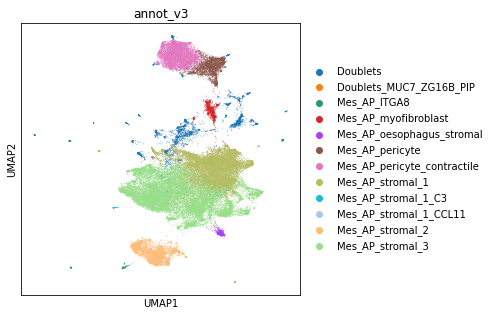

In [74]:
ON = {O:N for O,N in zip(peri.obs_names,peri.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [75]:
myo = adata[adata.obs.annot_v3.isin(['Mes_AP_myofibroblast'])].copy()

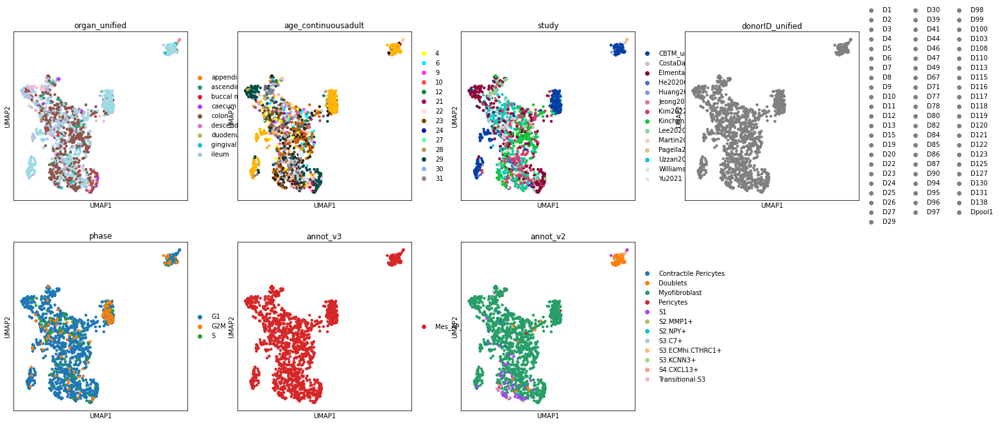

In [77]:
sc.pp.neighbors(
        myo,
            use_rep="X_scvi",
            n_pcs=myo.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(myo, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(myo, color=['organ_unified', 'age_continuousadult','study','donorID_unified','phase','annot_v3','annot_v2'])

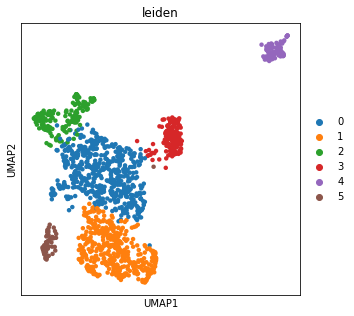

In [82]:
sc.tl.leiden(myo, resolution = 0.4, neighbors_key="neighbors_scvi")
sc.pl.umap(myo, color=['leiden'])

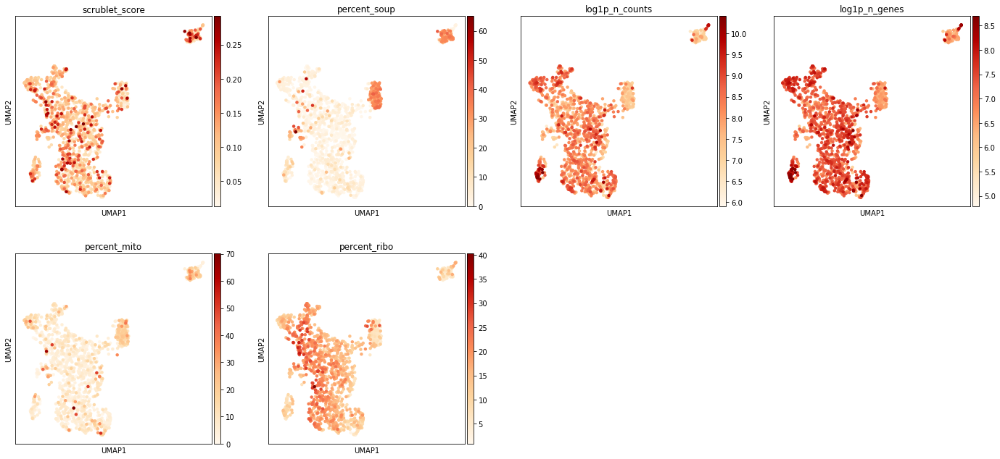

In [80]:
#plot some basic QC
sc.pl.umap(myo, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

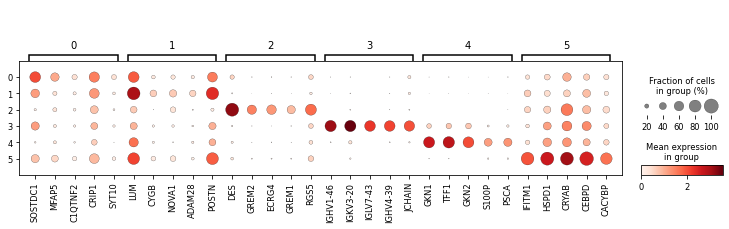

In [83]:
myo.raw = myo.copy()
mkst = calc_marker_stats(myo, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(myo, groupby='leiden', mks=mks)

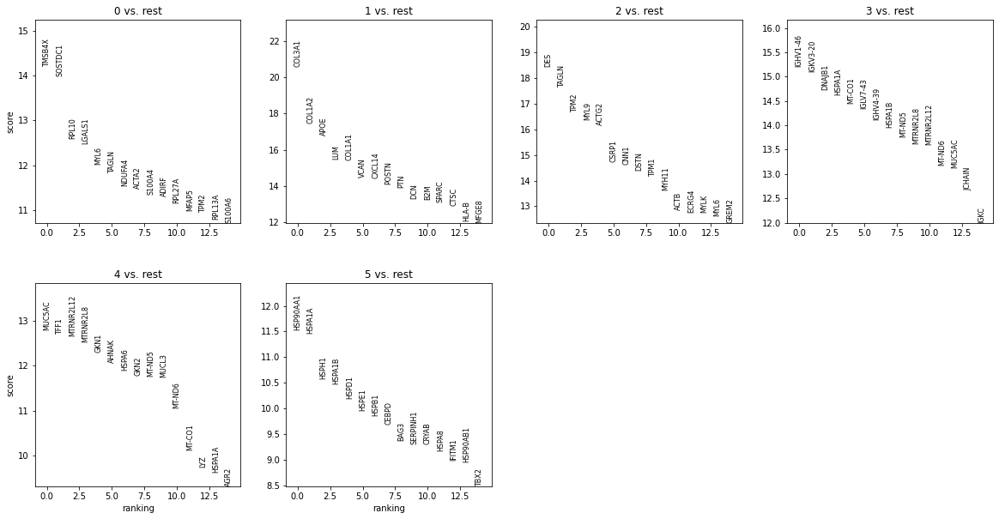

In [84]:
sc.tl.rank_genes_groups(myo, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(myo, n_genes=15, sharey=False)

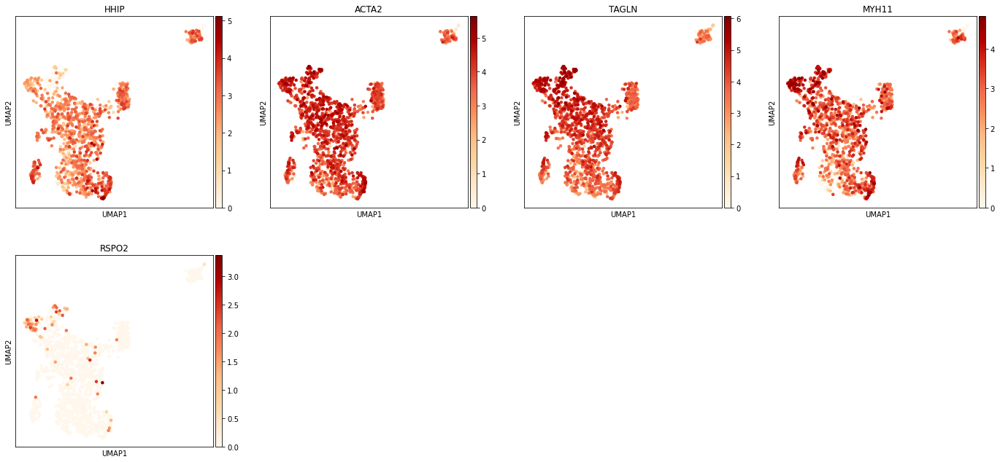

In [85]:
sc.pl.umap(myo,color=['HHIP','ACTA2','TAGLN','MYH11','RSPO2'],cmap='OrRd')

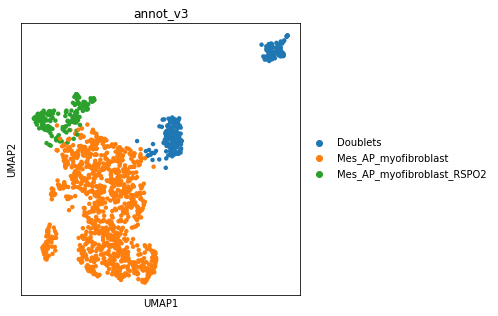

In [110]:
new_cluster_names = [
    'Mes_AP_myofibroblast','Mes_AP_myofibroblast', #0,1
    'Mes_AP_myofibroblast_RSPO2','Doublets',#2,3
    'Doublets','Mes_AP_myofibroblast',#4,5

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

myo.obs['annot_v3'] = [conv[x] for x in myo.obs['leiden']]
sc.pl.umap(myo,color='annot_v3')

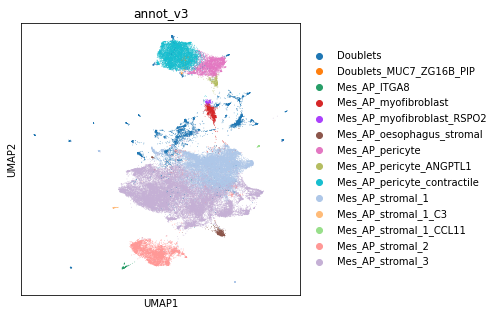

In [111]:
ON = {O:N for O,N in zip(myo.obs_names,myo.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

revisit pericytes, looks like potential extra heterogeneity

In [88]:
per = adata[adata.obs.annot_v3.isin(['Mes_AP_pericyte'])].copy()

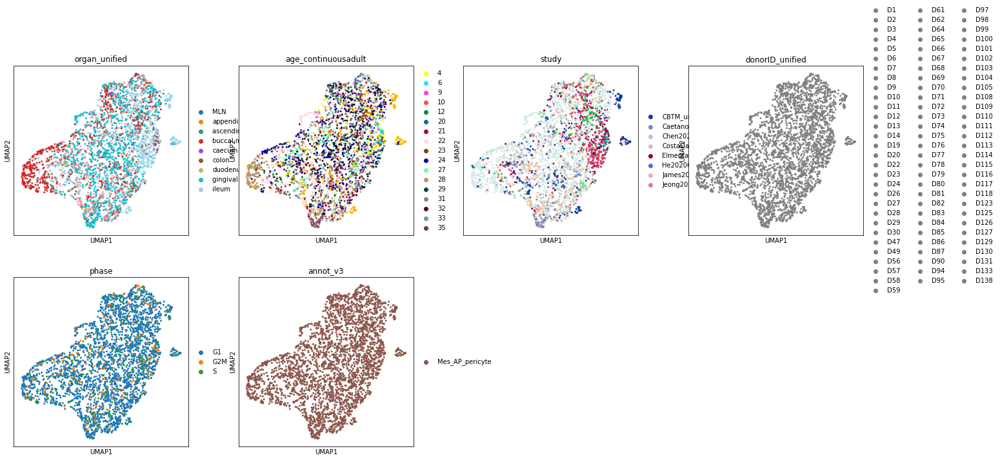

In [89]:
sc.pp.neighbors(
        per,
            use_rep="X_scvi",
            n_pcs=per.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(per, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(per, color=['organ_unified', 'age_continuousadult','study','donorID_unified','phase','annot_v3'])

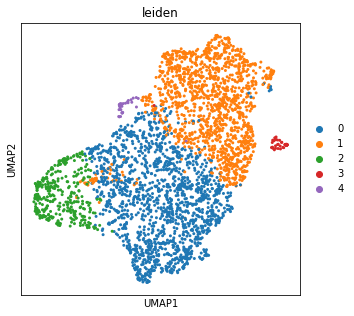

In [92]:
sc.tl.leiden(per, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(per, color=['leiden'])

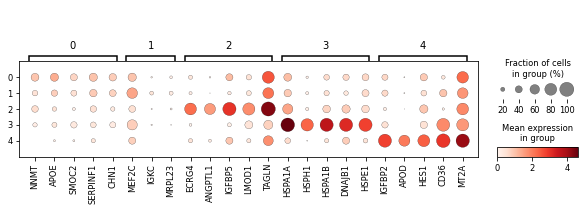

In [93]:
per.raw = per.copy()
mkst = calc_marker_stats(per, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(per, groupby='leiden', mks=mks)

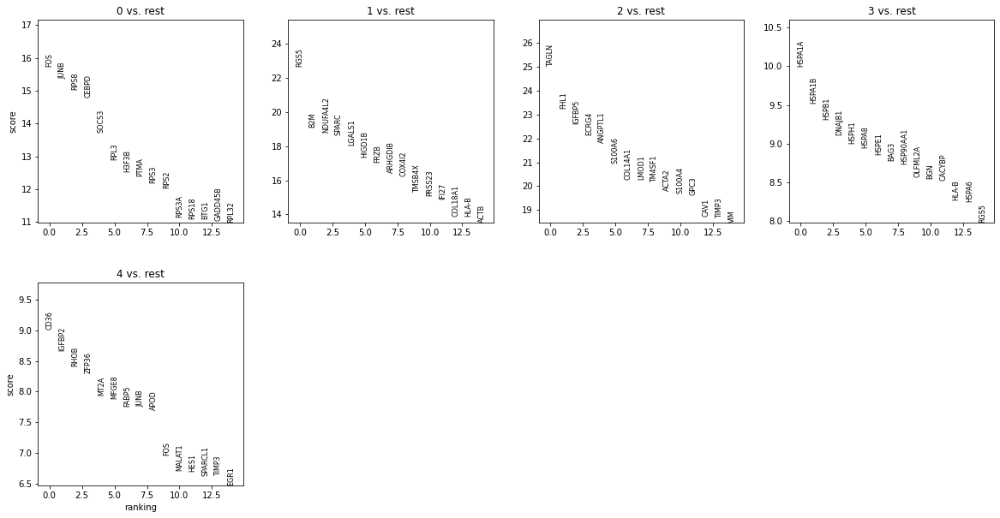

In [94]:
sc.tl.rank_genes_groups(per, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(per, n_genes=15, sharey=False)

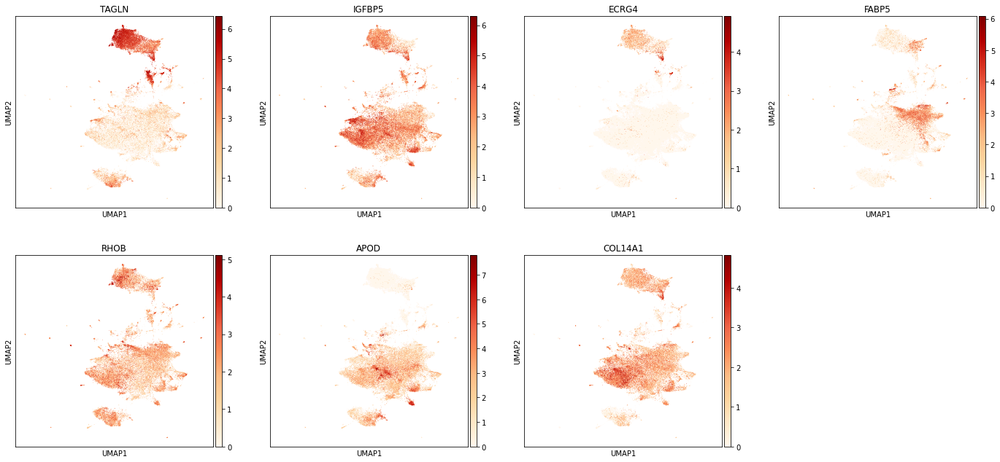

In [105]:
sc.pl.umap(adata,color=['TAGLN','IGFBP5','ECRG4','FABP5','RHOB','APOD','COL14A1'],cmap='OrRd')

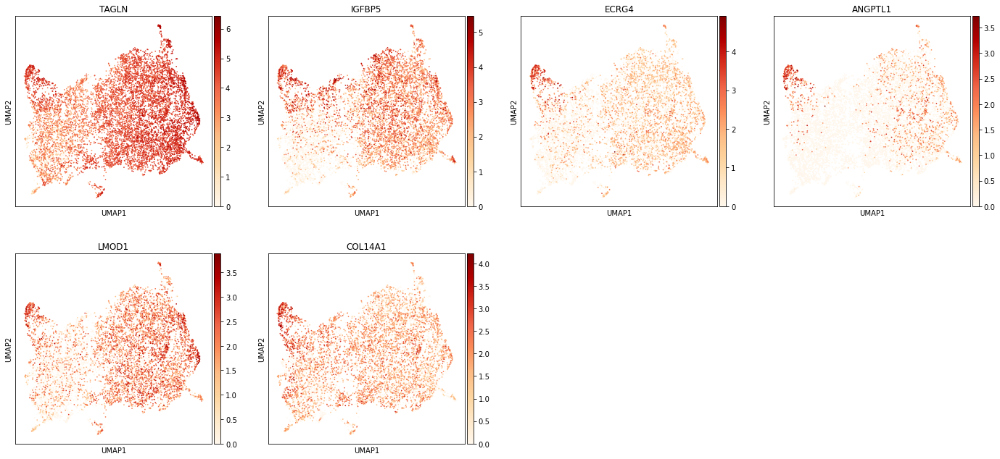

In [106]:
sc.pl.umap(peri,color=['TAGLN','IGFBP5','ECRG4','ANGPTL1','LMOD1','COL14A1'],cmap='OrRd')

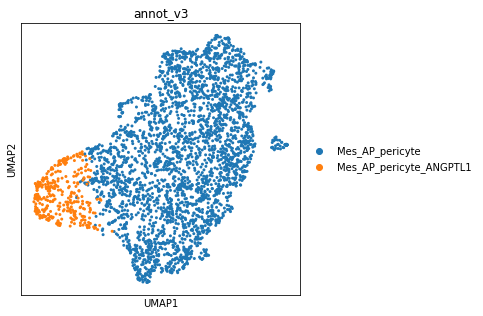

In [171]:
new_cluster_names = [
    'Mes_AP_pericyte','Mes_AP_pericyte', #0,1
    'Mes_AP_pericyte_ANGPTL1','Mes_AP_pericyte',#2,3
    'Mes_AP_pericyte'#4

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

per.obs['annot_v3'] = [conv[x] for x in per.obs['leiden']]
sc.pl.umap(per,color='annot_v3')

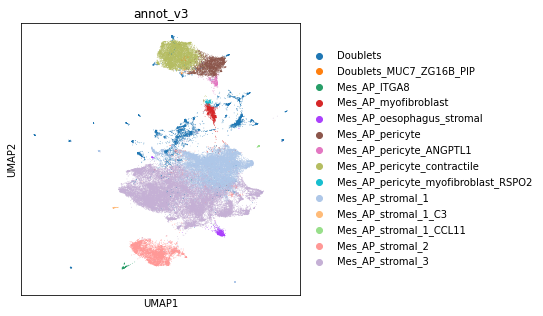

In [108]:
ON = {O:N for O,N in zip(per.obs_names,per.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [112]:
list(adata.obs.annot_v3.unique())

['Mes_AP_stromal_1',
 'Mes_AP_oesophagus_stromal',
 'Doublets',
 'Mes_AP_myofibroblast',
 'Mes_AP_pericyte',
 'Mes_AP_stromal_3',
 'Mes_AP_ITGA8',
 'Mes_AP_pericyte_contractile',
 'Mes_AP_stromal_2',
 'Mes_AP_myofibroblast_RSPO2',
 'Mes_AP_pericyte_ANGPTL1',
 'Mes_AP_stromal_1_CCL11',
 'Doublets_MUC7_ZG16B_PIP',
 'Mes_AP_stromal_1_C3']

In [116]:
stro = adata[adata.obs.annot_v3.isin(['Mes_AP_stromal_1',
 'Mes_AP_oesophagus_stromal',
 'Mes_AP_stromal_3',
 'Mes_AP_stromal_1_CCL11',
 'Mes_AP_stromal_1_C3'])].copy()

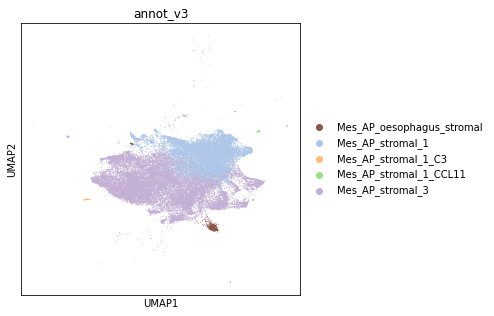

In [117]:
sc.pl.umap(stro,color='annot_v3')

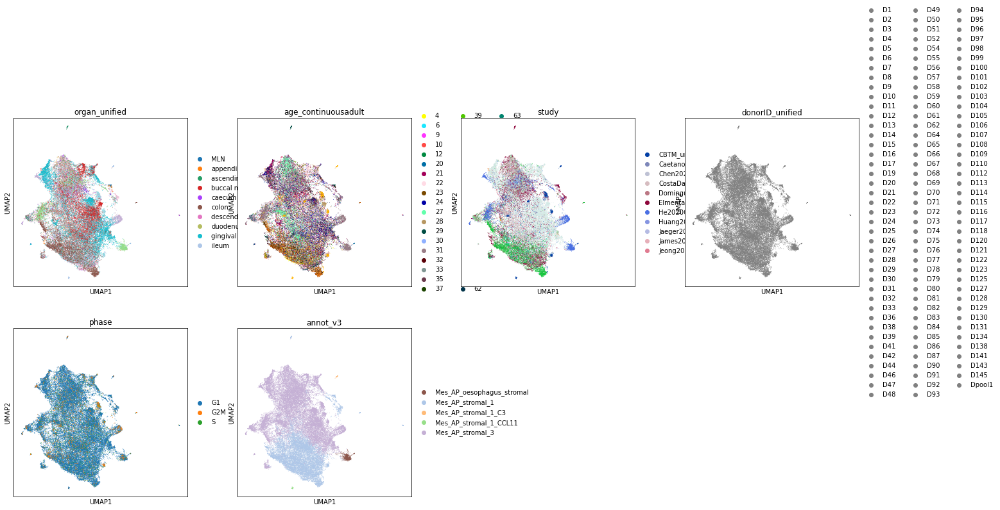

In [118]:
sc.pp.neighbors(
        stro,
            use_rep="X_scvi",
            n_pcs=stro.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(stro, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(stro, color=['organ_unified', 'age_continuousadult','study','donorID_unified','phase','annot_v3'])

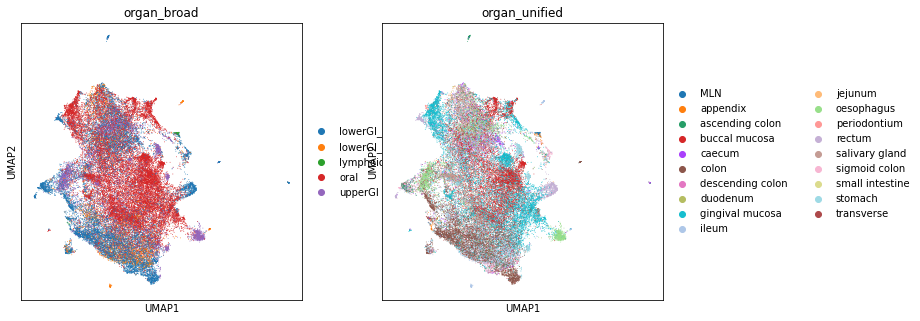

In [163]:
sc.pl.umap(stro,color=['organ_broad','organ_unified'])

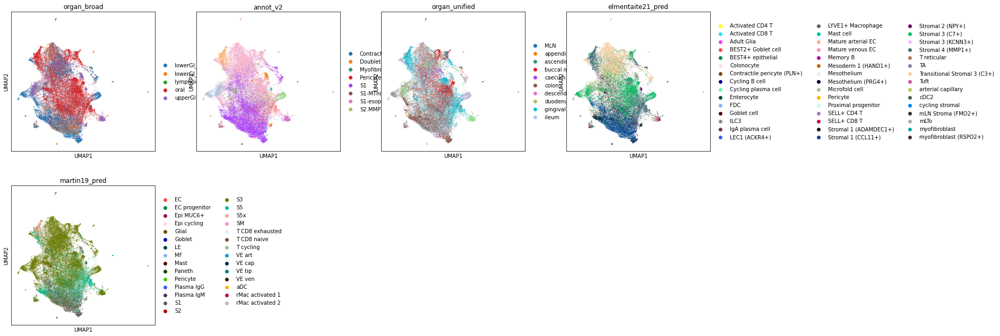

In [158]:
sc.pl.umap(stro,color=['organ_broad','annot_v2','organ_unified','elmentaite21_pred','martin19_pred'])

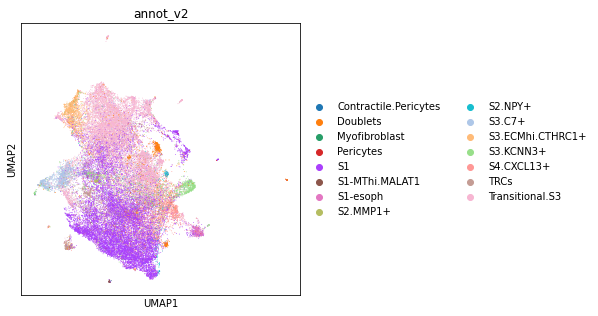

In [179]:
sc.pl.umap(stro,color='annot_v2')

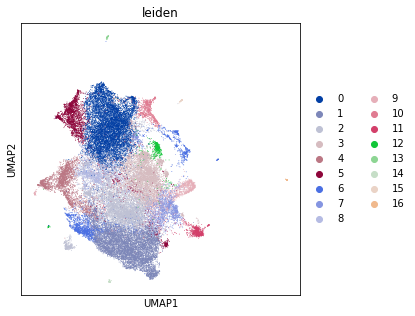

In [146]:
sc.tl.leiden(stro, resolution = 0.6, neighbors_key="neighbors_scvi")
sc.pl.umap(stro, color=['leiden'])

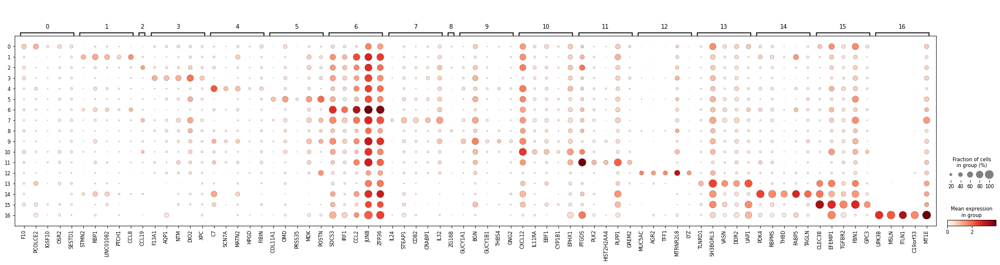

In [147]:
stro.raw = stro.copy()
mkst = calc_marker_stats(stro, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(stro, groupby='leiden', mks=mks)

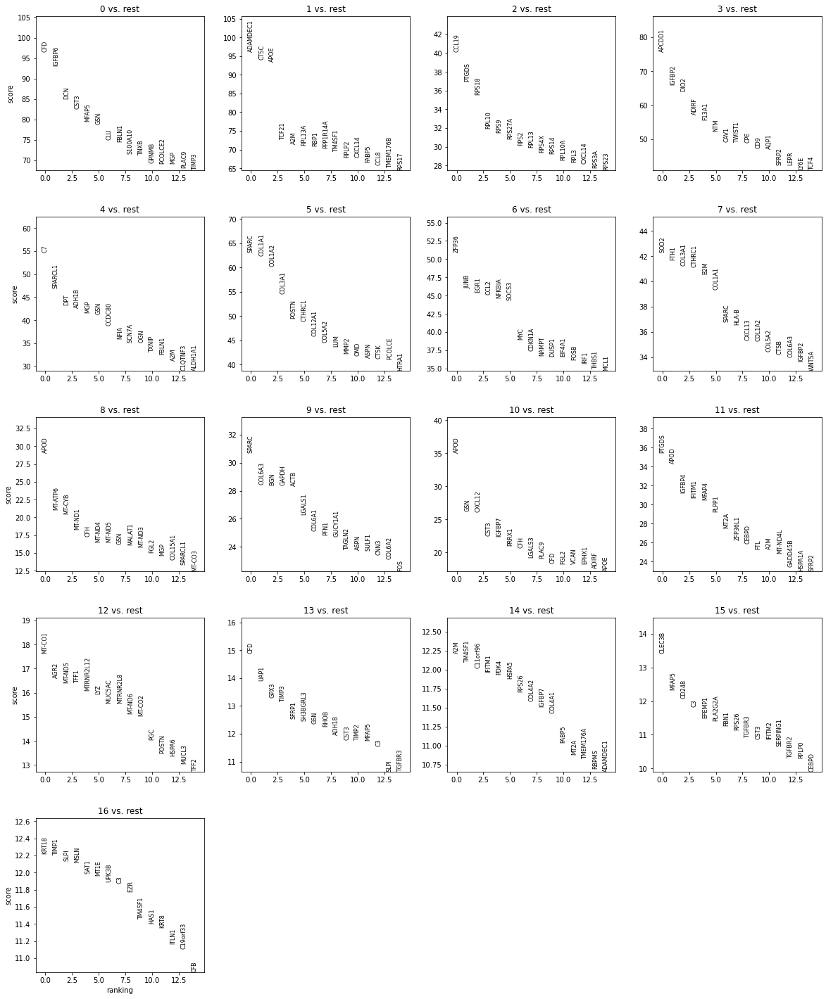

In [152]:
sc.tl.rank_genes_groups(stro, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(stro, n_genes=15, sharey=False)

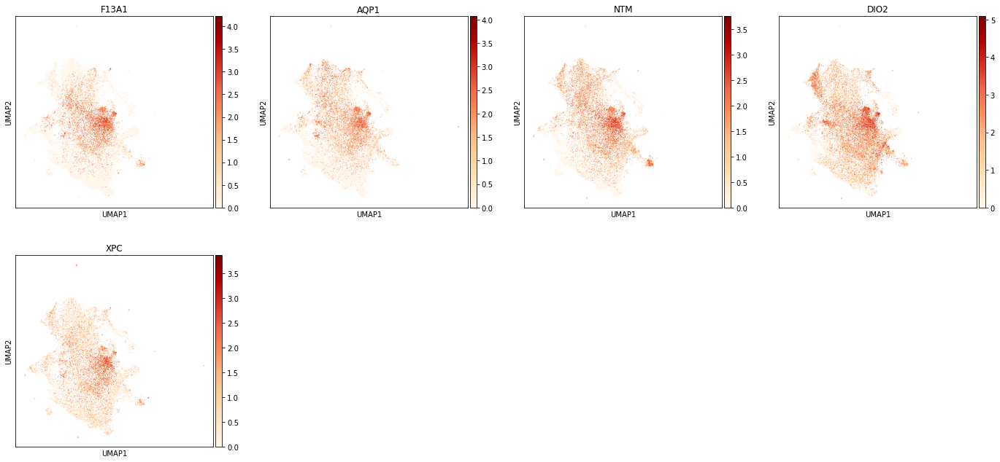

In [166]:
sc.pl.umap(stro,color=['F13A1','AQP1','NTM','DIO2','XPC'],cmap='OrRd')

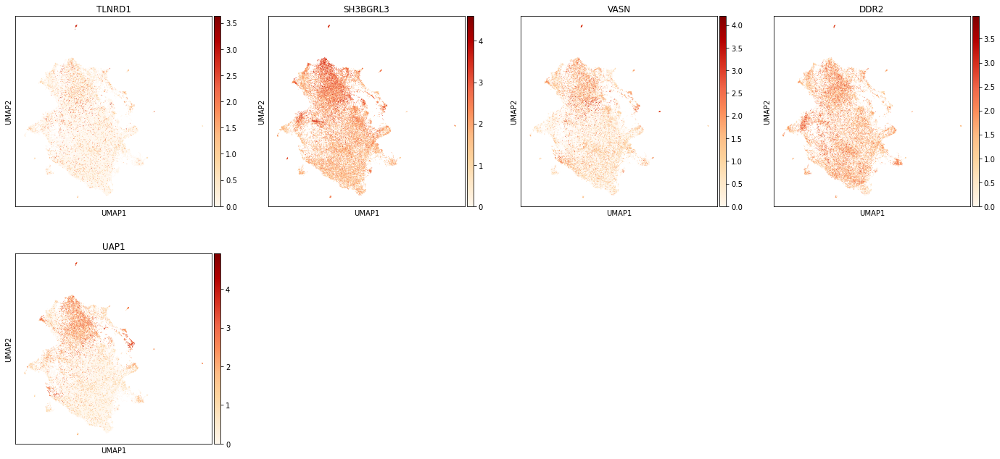

In [168]:
sc.pl.umap(stro,color=['TLNRD1','SH3BGRL3','VASN','DDR2','UAP1','CFD','GPX3','TIMP3','SFRP1','GSN'],cmap='OrRd')

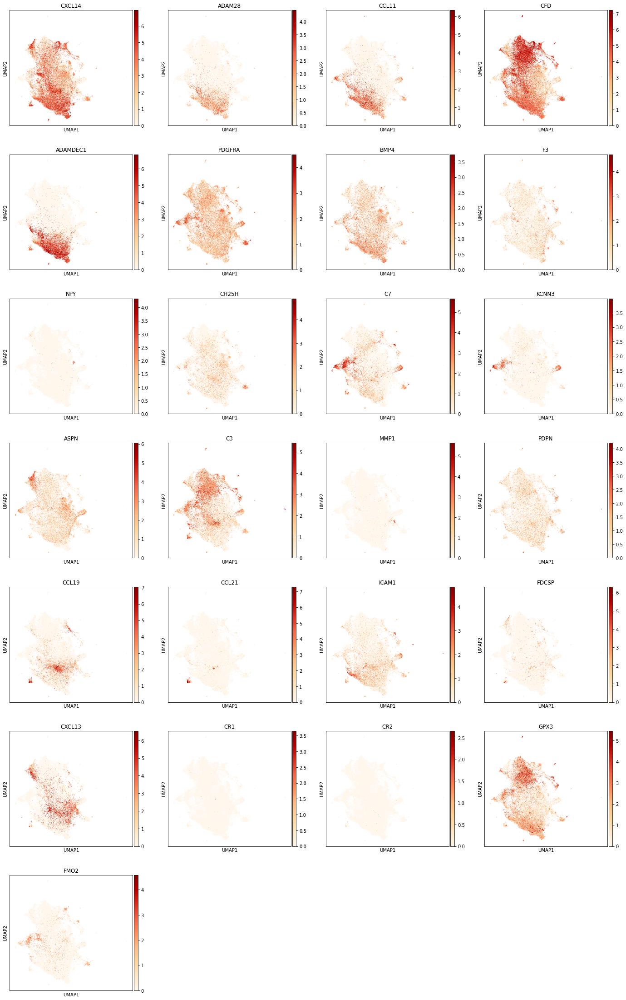

In [144]:
sc.pl.umap(stro,color=['CXCL14','ADAM28','CCL11','CFD','ADAMDEC1', #stromal 1
                        'PDGFRA','BMP4','F3','NPY','CH25H', #stromal 2
                        'C7','KCNN3','ASPN','C3', #stromal 3
                       'MMP1','PDPN', #stromal 4
                       'CCL19','CCL21','ICAM1', #mLTo/FRC
                        'FDCSP','CXCL13','CR1','CR2',
                        'GPX3','FMO2', #mLN stroma
                      ],cmap='OrRd')

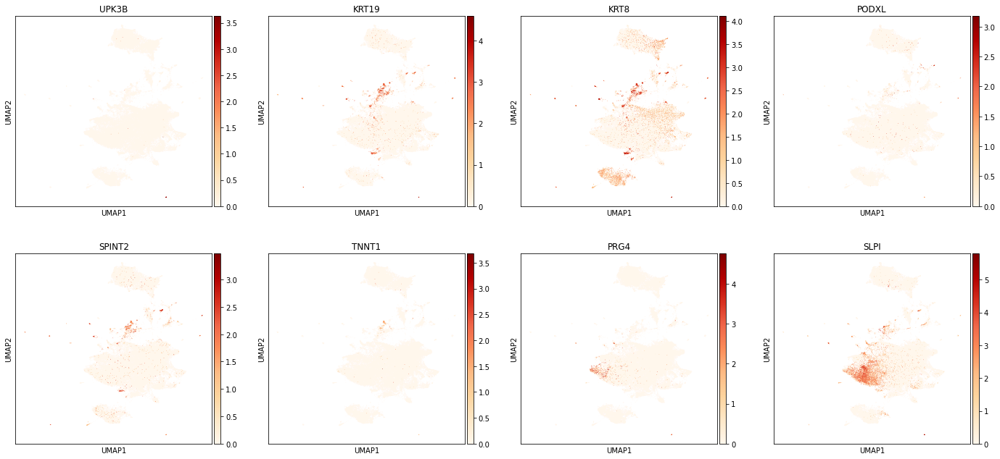

In [132]:
sc.pl.umap(adata,color=['UPK3B','KRT19','KRT8','PODXL','SPINT2','TNNT1','PRG4',#mesothelium
                        'SLPI'],cmap='OrRd')

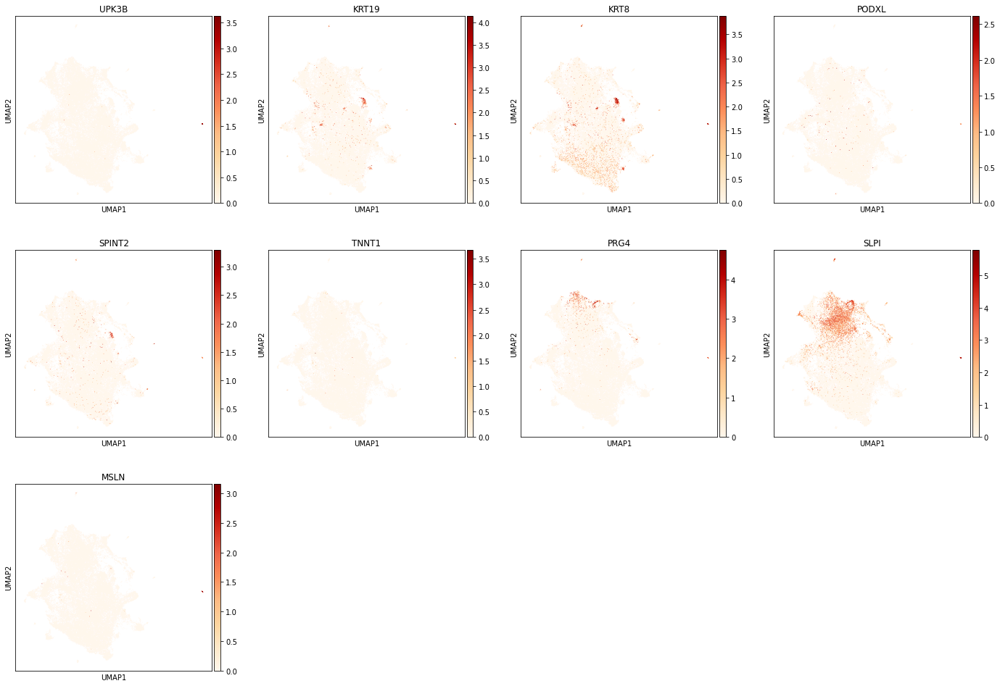

In [134]:
sc.pl.umap(stro,color=['UPK3B','KRT19','KRT8','PODXL','SPINT2','TNNT1','PRG4',#mesothelium
                        'SLPI','MSLN'],cmap='OrRd')

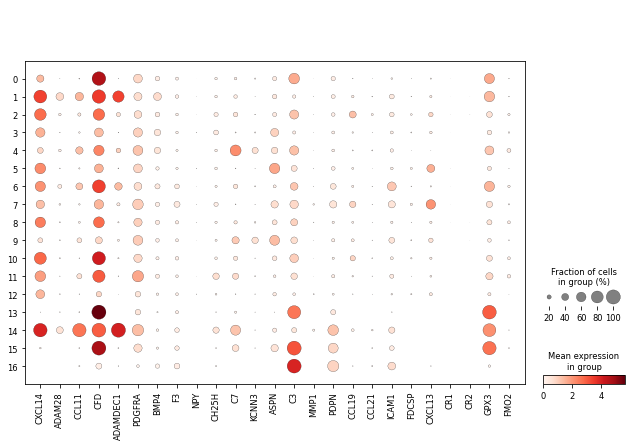

In [149]:
sc.pl.dotplot(stro,var_names=['CXCL14','ADAM28','CCL11','CFD','ADAMDEC1', #stromal 1
                        'PDGFRA','BMP4','F3','NPY','CH25H', #stromal 2
                        'C7','KCNN3','ASPN','C3', #stromal 3
                       'MMP1','PDPN', #stromal 4
                       'CCL19','CCL21','ICAM1', #mLTo/FRC
                        'FDCSP','CXCL13','CR1','CR2',
                        'GPX3','FMO2', #mLN stroma
                             ],groupby='leiden')

         Falling back to preprocessing with `sc.pp.pca` and default params.


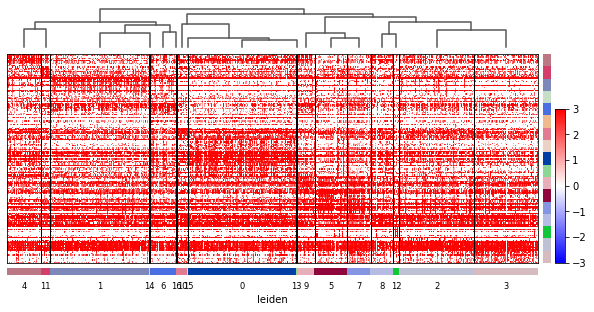

In [151]:
sc.tl.rank_genes_groups(stro,groupby='leiden',method='wilcoxon')
sc.tl.dendrogram(stro, groupby='leiden')
sc.pl.rank_genes_groups_heatmap(stro,groupby='leiden', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='bwr')

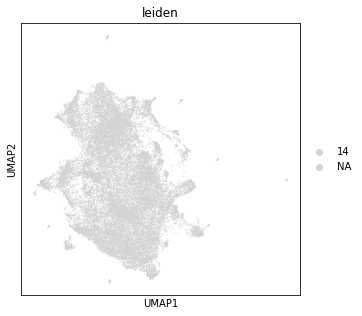

In [169]:
sc.pl.umap(stro,color='leiden',groups='14')

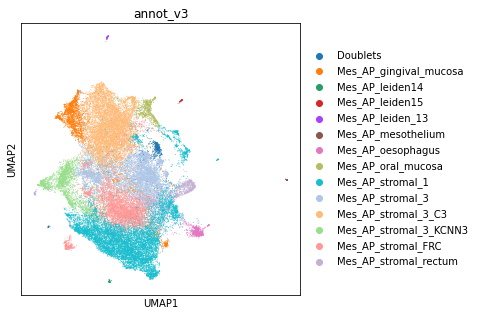

In [172]:
new_cluster_names = [
    'Mes_AP_stromal_3_C3','Mes_AP_stromal_1', #0,1
    'Mes_AP_stromal_FRC','Mes_AP_stromal_3',#2,3
    'Mes_AP_stromal_3_KCNN3','Mes_AP_gingival_mucosa',#4,5
    'Mes_AP_stromal_1','Mes_AP_stromal_1',#6,7
    'Mes_AP_stromal_3','Mes_AP_stromal_rectum',#8,9
    'Mes_AP_oral_mucosa','Mes_AP_oesophagus',#10,11
    'Doublets','Mes_AP_leiden_13',#12,13
    'Mes_AP_leiden14','Mes_AP_leiden15',#14,15
    'Mes_AP_mesothelium' #16

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

stro.obs['annot_v3'] = [conv[x] for x in stro.obs['leiden']]
sc.pl.umap(stro,color='annot_v3')

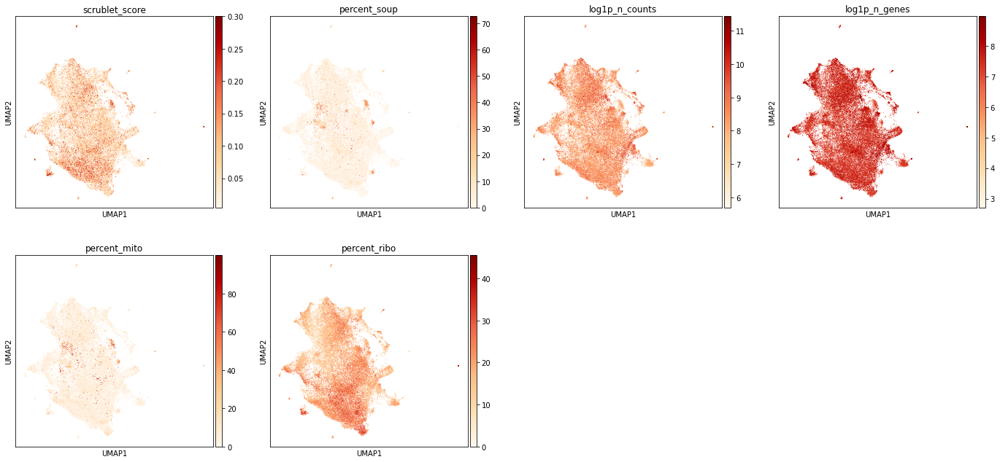

In [165]:
#plot some basic QC
sc.pl.umap(stro, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

In [173]:
frc = stro[stro.obs.annot_v3.isin(['Mes_AP_stromal_FRC'])]

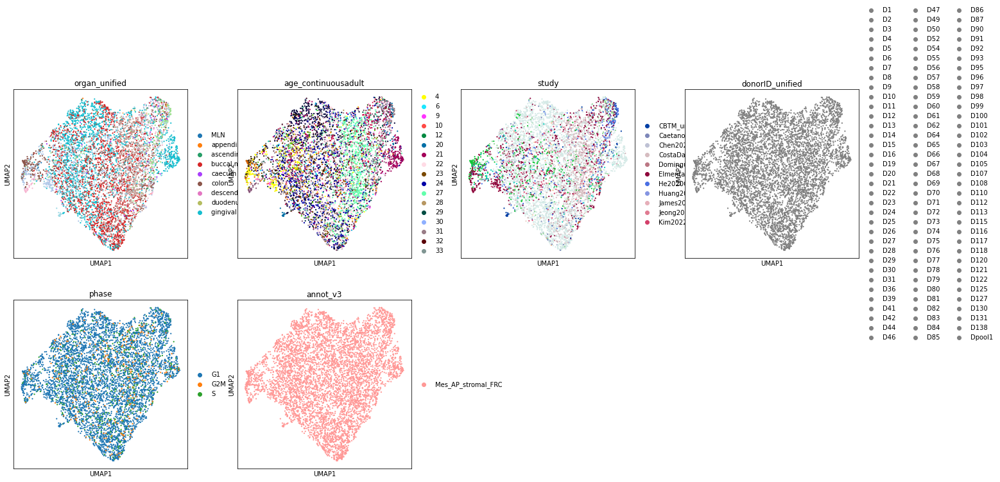

In [174]:
sc.pp.neighbors(
        frc,
            use_rep="X_scvi",
            n_pcs=frc.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(frc, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(frc, color=['organ_unified', 'age_continuousadult','study','donorID_unified','phase','annot_v3'])

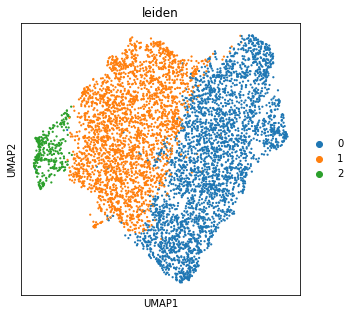

In [175]:
sc.tl.leiden(frc, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(frc, color=['leiden'])

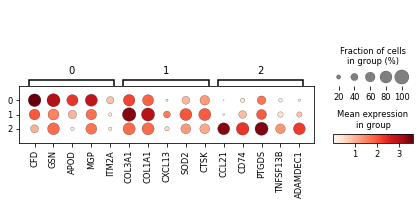

In [176]:
frc.raw = frc.copy()
mkst = calc_marker_stats(frc, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(frc, groupby='leiden', mks=mks)

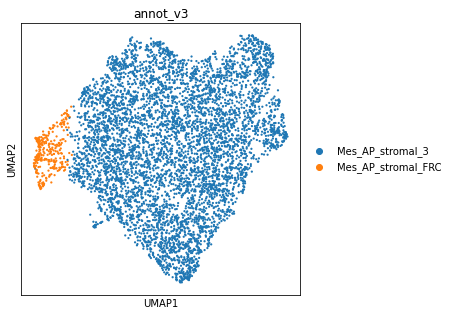

In [177]:
new_cluster_names = [
    'Mes_AP_stromal_3','Mes_AP_stromal_3', #0,1
    'Mes_AP_stromal_FRC'#2,3

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

frc.obs['annot_v3'] = [conv[x] for x in frc.obs['leiden']]
sc.pl.umap(frc,color='annot_v3')

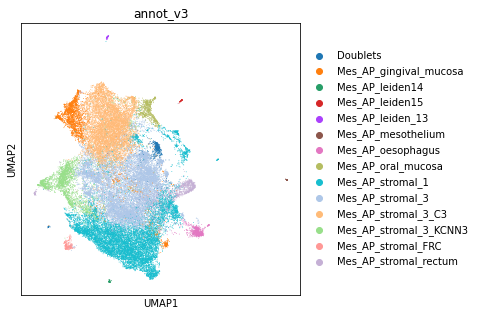

In [178]:
ON = {O:N for O,N in zip(frc.obs_names,frc.obs["annot_v3"])}
stro.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(stro.obs_names, stro.obs["annot_v3"])]
sc.pl.umap(stro,color='annot_v3')

In [180]:
gm = stro[stro.obs.annot_v3.isin(['Mes_AP_gingival_mucosa'])]

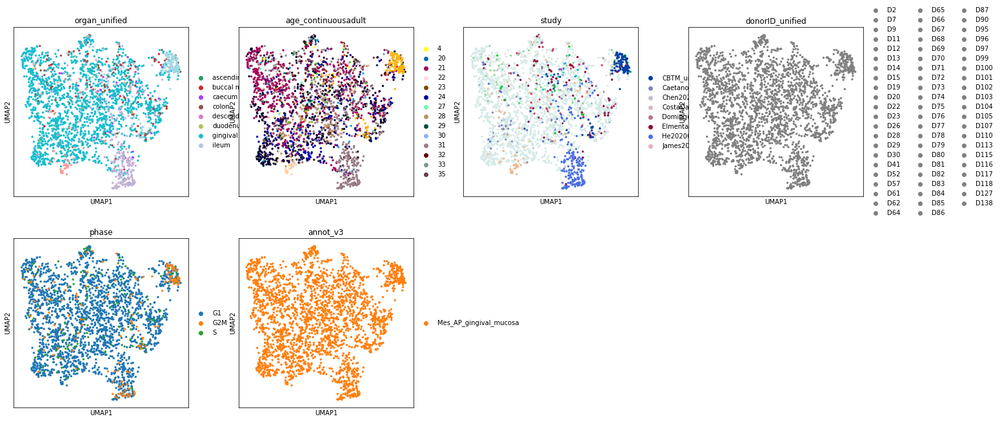

In [181]:
sc.pp.neighbors(
        gm,
            use_rep="X_scvi",
            n_pcs=gm.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(gm, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(gm, color=['organ_unified', 'age_continuousadult','study','donorID_unified','phase','annot_v3'])

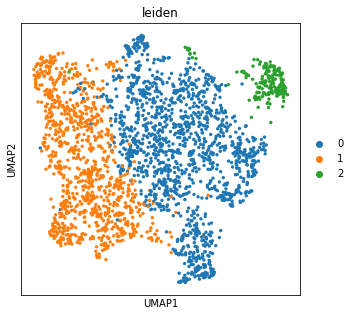

In [185]:
sc.tl.leiden(gm, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(gm, color=['leiden'])

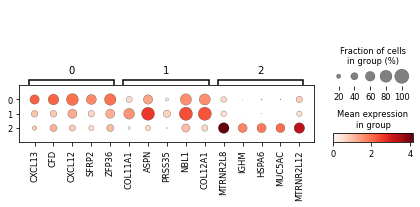

In [186]:
gm.raw = gm.copy()
mkst = calc_marker_stats(gm, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(gm, groupby='leiden', mks=mks)

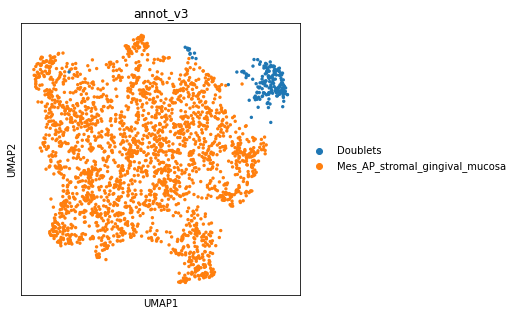

In [187]:
new_cluster_names = [
    'Mes_AP_stromal_gingival_mucosa','Mes_AP_stromal_gingival_mucosa', #0,1
    'Doublets'#2,3

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

gm.obs['annot_v3'] = [conv[x] for x in gm.obs['leiden']]
sc.pl.umap(gm,color='annot_v3')

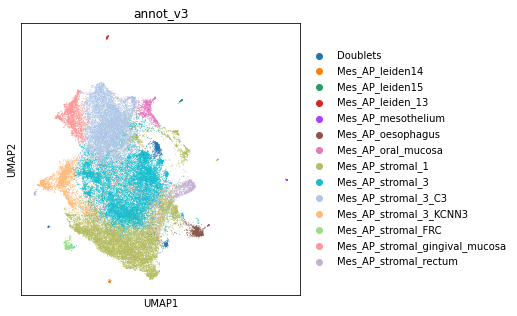

In [188]:
ON = {O:N for O,N in zip(gm.obs_names,gm.obs["annot_v3"])}
stro.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(stro.obs_names, stro.obs["annot_v3"])]
sc.pl.umap(stro,color='annot_v3')

In [189]:
os = stro[stro.obs.annot_v3.isin(['Mes_AP_oesophagus'])]

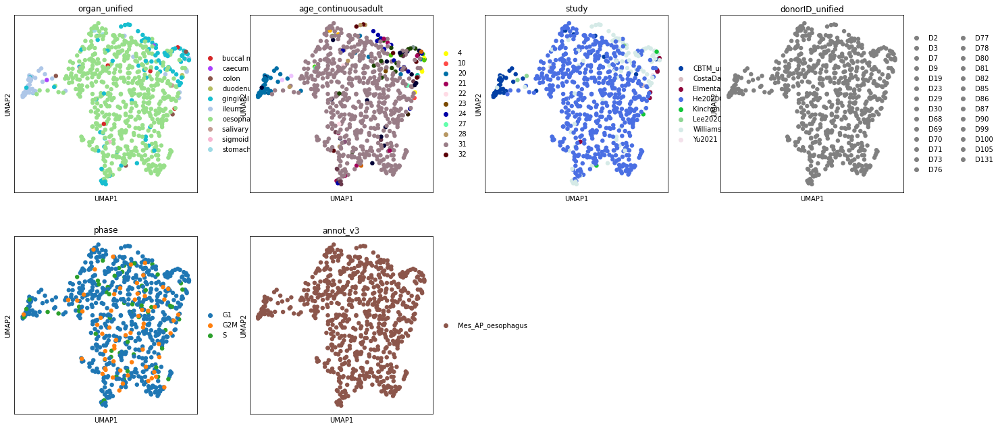

In [190]:
sc.pp.neighbors(
        os,
            use_rep="X_scvi",
            n_pcs=os.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(os, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(os, color=['organ_unified', 'age_continuousadult','study','donorID_unified','phase','annot_v3'])

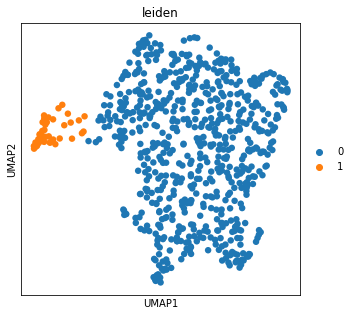

In [191]:
sc.tl.leiden(os, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(os, color=['leiden'])

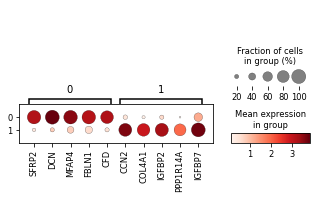

In [193]:
os.raw = os.copy()
mkst = calc_marker_stats(os, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(os, groupby='leiden', mks=mks)

In [212]:
s1 = stro[stro.obs.annot_v3.isin(['Mes_AP_stromal_1'])]

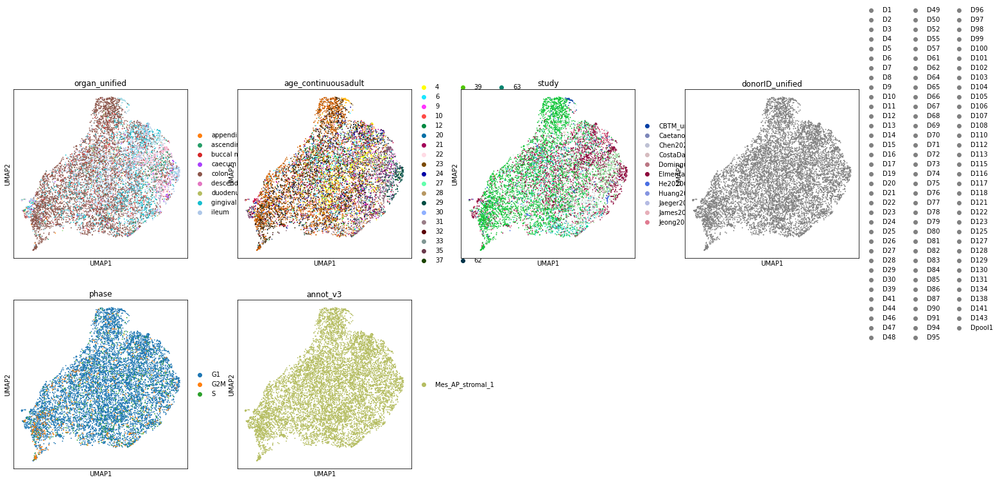

In [213]:
sc.pp.neighbors(
        s1,
            use_rep="X_scvi",
            n_pcs=s1.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(s1, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(s1, color=['organ_unified', 'age_continuousadult','study','donorID_unified','phase','annot_v3'])

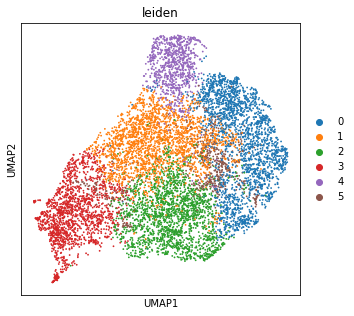

In [214]:
sc.tl.leiden(s1, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(s1, color=['leiden'])

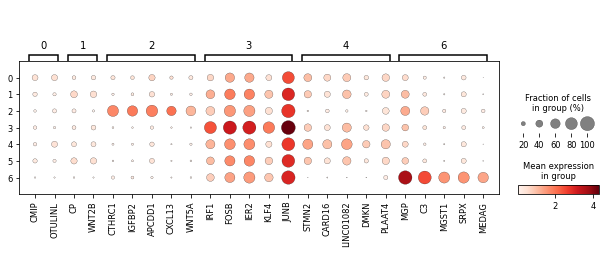

In [197]:
s1.raw = s1.copy()
mkst = calc_marker_stats(s1, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(s1, groupby='leiden', mks=mks)

gingival fibroblasts: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8359928/pdf/nihms-1713733.pdf

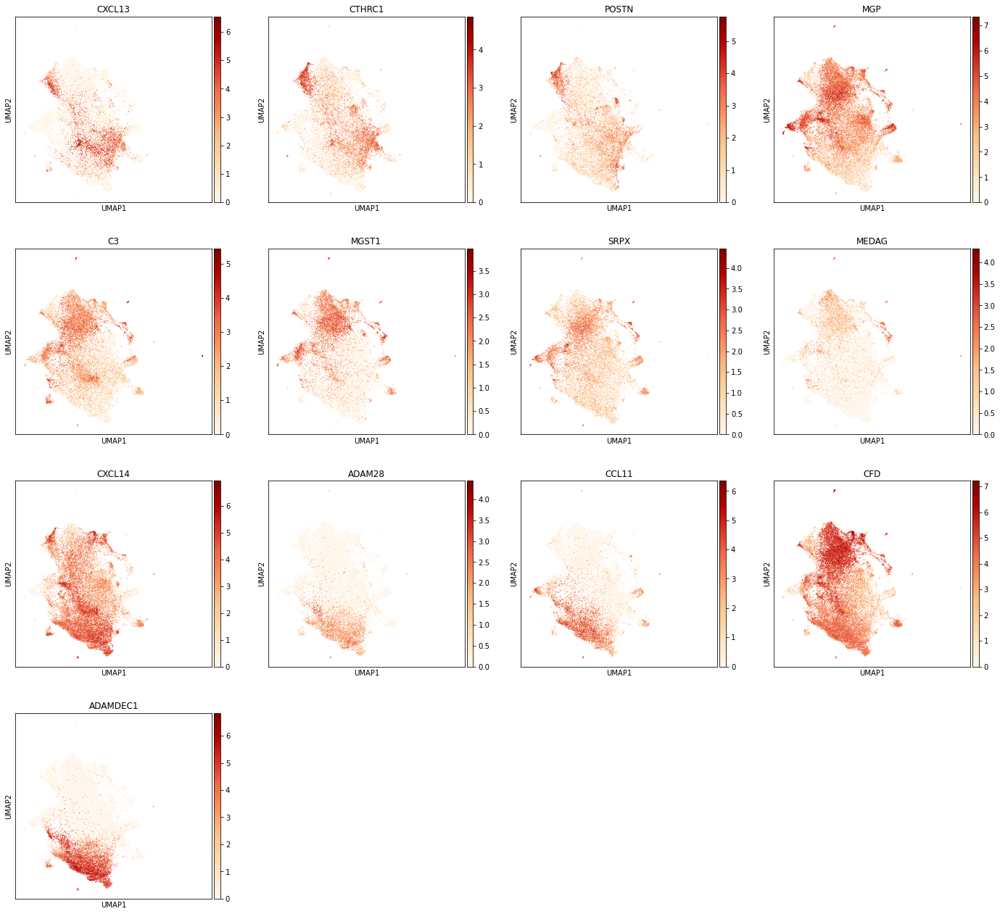

In [207]:
sc.pl.umap(stro,color=['CXCL13','CTHRC1','POSTN','MGP','C3','MGST1','SRPX','MEDAG',
                      
                      'CXCL14','ADAM28','CCL11','CFD','ADAMDEC1', #stromal 1
                      ],cmap='OrRd')

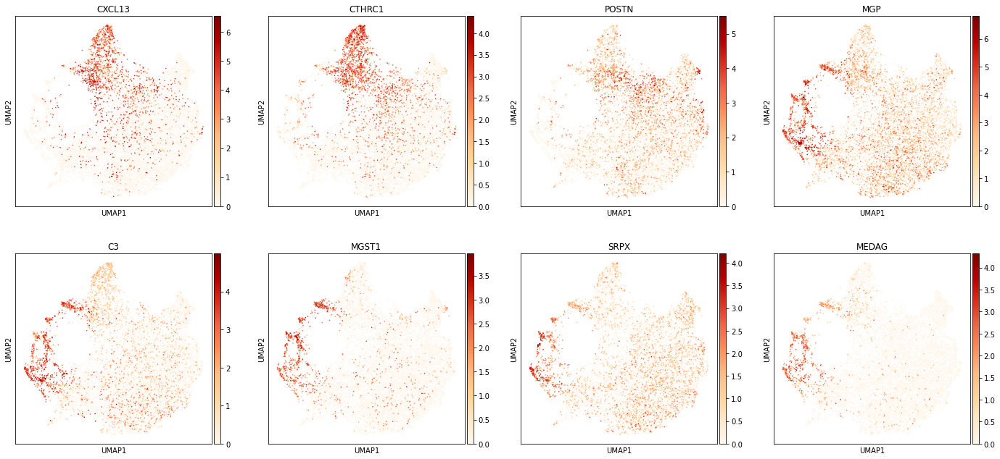

In [206]:
sc.pl.umap(s1,color=['CXCL13','CTHRC1','POSTN','MGP','C3','MGST1','SRPX','MEDAG'],cmap='OrRd')

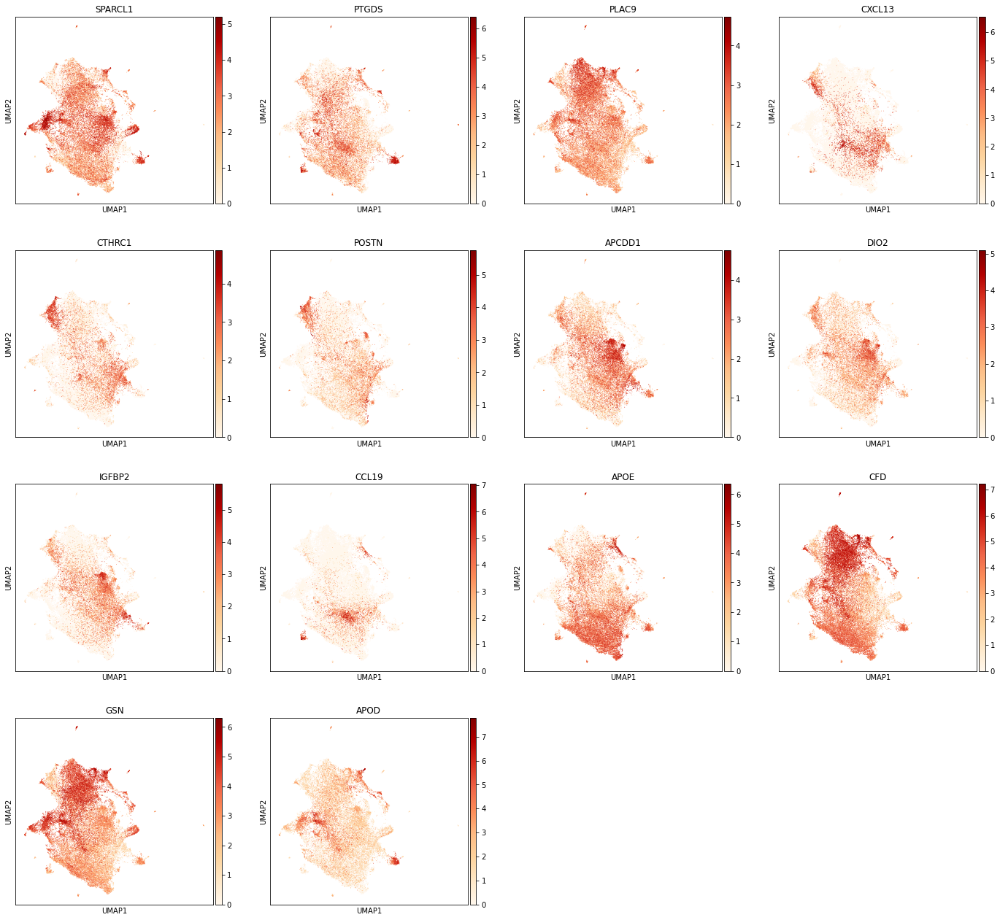

In [203]:
#oral mucosa fibroblasts: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8359928/pdf/nihms-1713733.pdf
sc.pl.umap(stro,color=['SPARCL1','PTGDS','PLAC9', #1.1
            'CXCL13','CTHRC1','POSTN', #fibroblast 1.2
                               'APCDD1','DIO2','IGFBP2', #1.3
                               'CCL19','APOE',#1.4
                               'CFD','GSN','APOD',#1.5
                      ],cmap='OrRd')

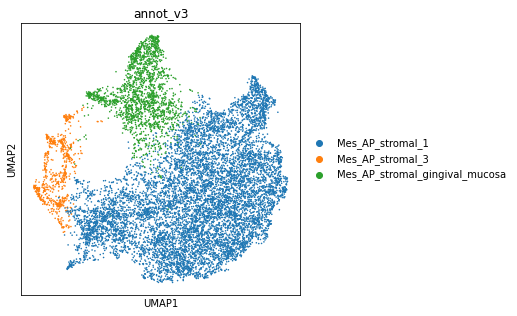

In [208]:
new_cluster_names = [
    'Mes_AP_stromal_1','Mes_AP_stromal_1', #0,1
    'Mes_AP_stromal_gingival_mucosa','Mes_AP_stromal_1',#2,3
    'Mes_AP_stromal_1','Mes_AP_stromal_1',#4,5
    'Mes_AP_stromal_3' #6

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

s1.obs['annot_v3'] = [conv[x] for x in s1.obs['leiden']]
sc.pl.umap(s1,color='annot_v3')

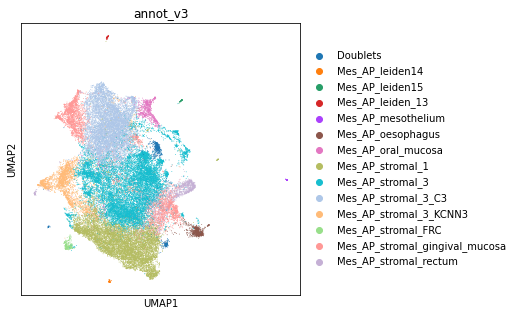

In [209]:
ON = {O:N for O,N in zip(s1.obs_names,s1.obs["annot_v3"])}
stro.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(stro.obs_names, stro.obs["annot_v3"])]
sc.pl.umap(stro,color='annot_v3')

In [218]:
s3 = stro[stro.obs.annot_v3.isin(['Mes_AP_stromal_3_KCNN3'])]

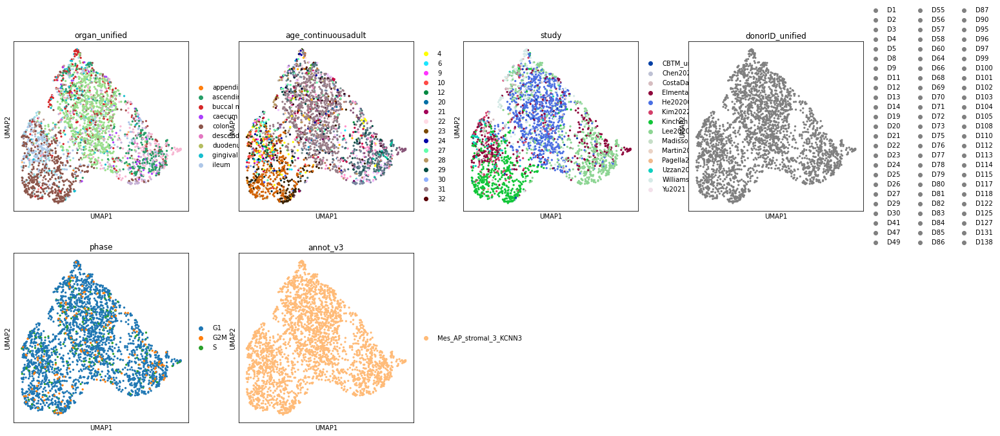

In [219]:
sc.pp.neighbors(
        s3,
            use_rep="X_scvi",
            n_pcs=s3.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(s3, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(s3, color=['organ_unified', 'age_continuousadult','study','donorID_unified','phase','annot_v3'])

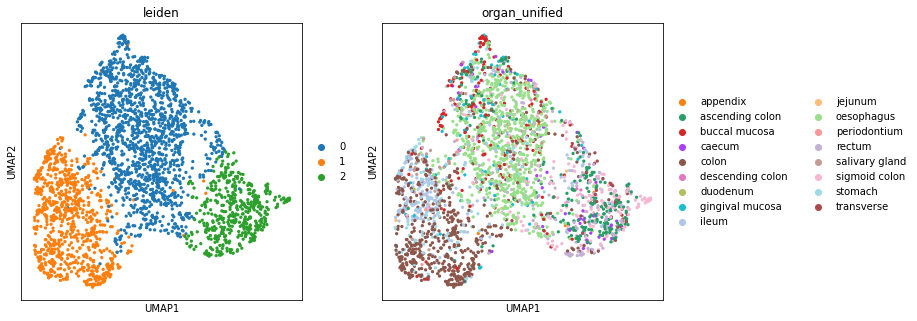

In [224]:
sc.tl.leiden(s3, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(s3, color=['leiden','organ_unified'])

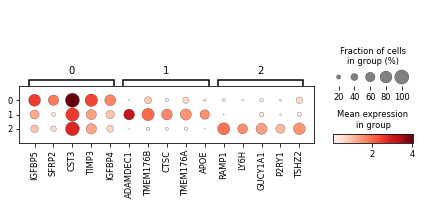

In [221]:
s3.raw = s3.copy()
mkst = calc_marker_stats(s3, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(s3, groupby='leiden', mks=mks)

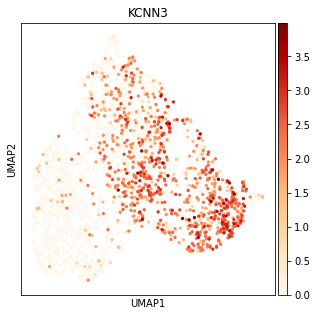

In [223]:
sc.pl.umap(s3,color=['KCNN3'],cmap='OrRd')

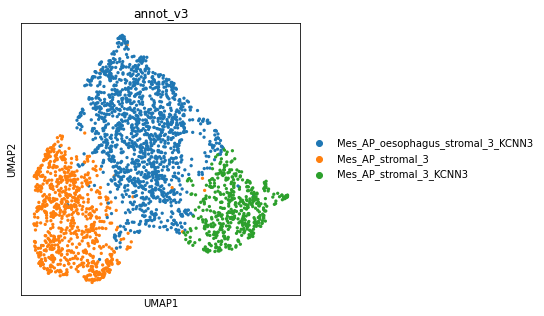

In [225]:
new_cluster_names = [
    'Mes_AP_oesophagus_stromal_3_KCNN3','Mes_AP_stromal_3', #0,1
    'Mes_AP_stromal_3_KCNN3'#2,3

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

s3.obs['annot_v3'] = [conv[x] for x in s3.obs['leiden']]
sc.pl.umap(s3,color='annot_v3')

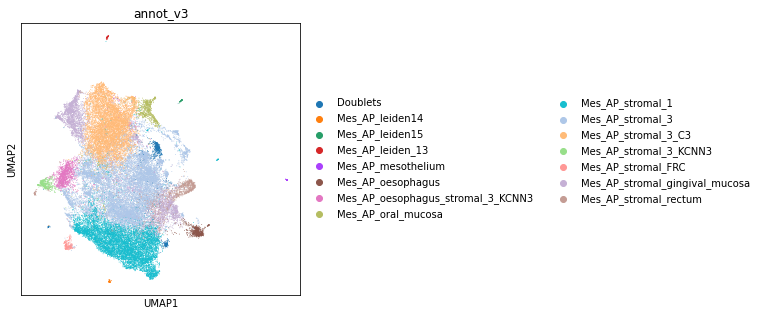

In [226]:
ON = {O:N for O,N in zip(s3.obs_names,s3.obs["annot_v3"])}
stro.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(stro.obs_names, stro.obs["annot_v3"])]
sc.pl.umap(stro,color='annot_v3')

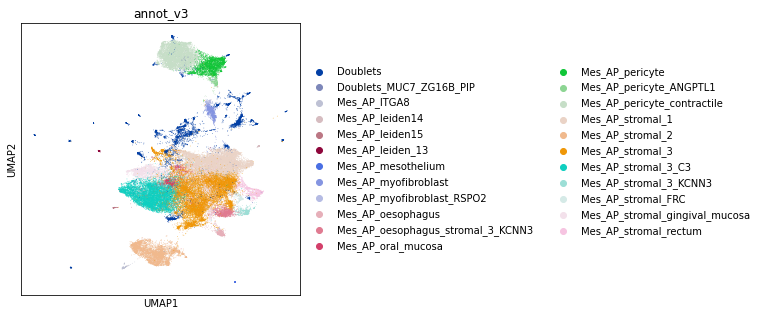

In [227]:
ON = {O:N for O,N in zip(stro.obs_names,stro.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [230]:
s2 = adata[adata.obs.annot_v3.isin(['Mes_AP_stromal_2','Mes_AP_ITGA8'])].copy()

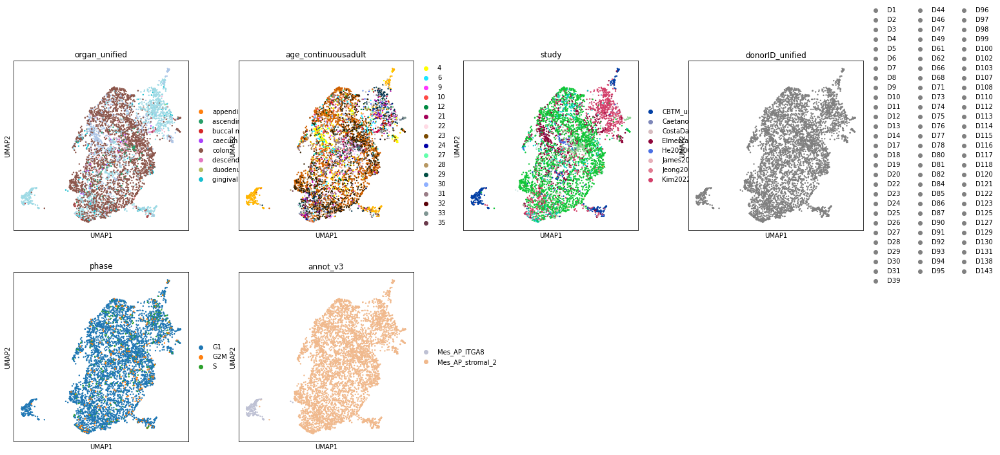

In [231]:
sc.pp.neighbors(
        s2,
            use_rep="X_scvi",
            n_pcs=s2.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(s2, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(s2, color=['organ_unified', 'age_continuousadult','study','donorID_unified','phase','annot_v3'])

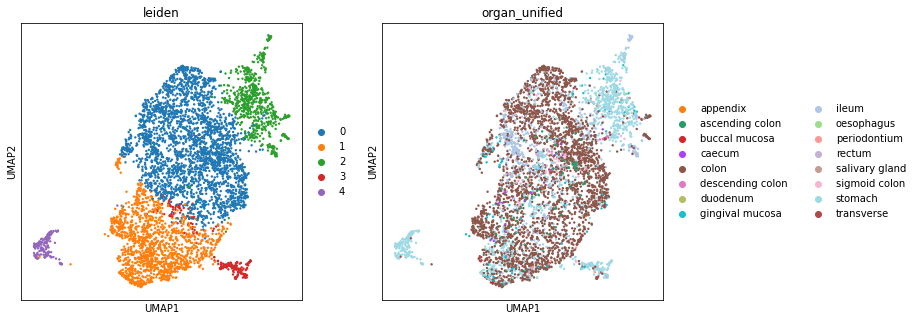

In [233]:
sc.tl.leiden(s2, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(s2, color=['leiden','organ_unified'])

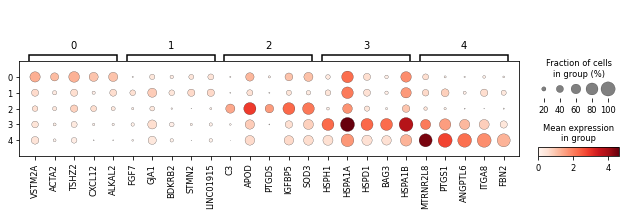

In [235]:
s2.raw = s2.copy()
mkst = calc_marker_stats(s2, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(s2, groupby='leiden', mks=mks)

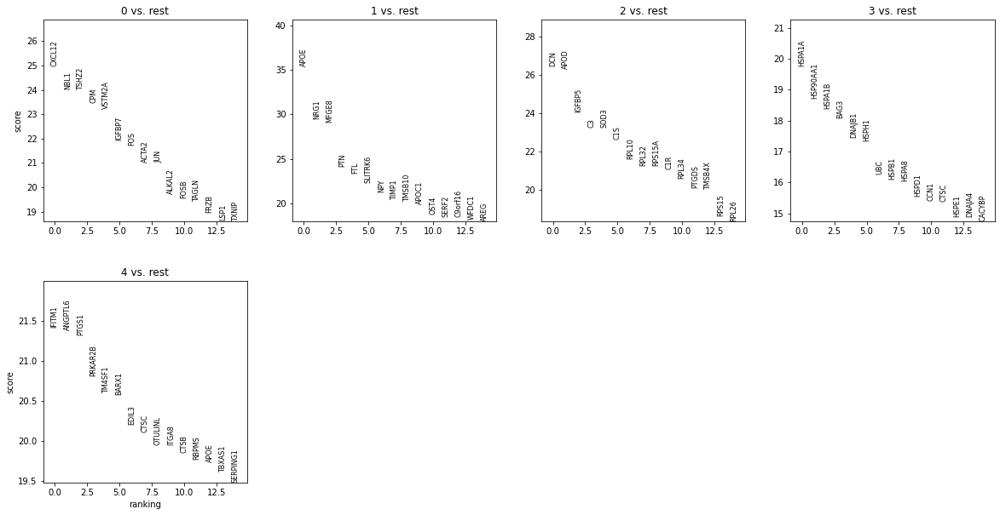

In [236]:
sc.tl.rank_genes_groups(s2, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(s2, n_genes=15, sharey=False)

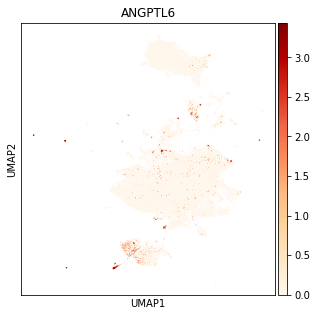

In [238]:
sc.pl.umap(adata,color='ANGPTL6',cmap='OrRd')

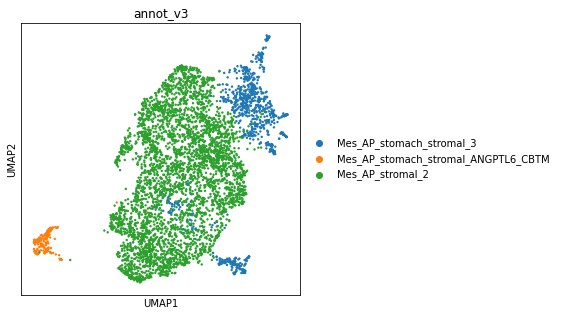

In [240]:
new_cluster_names = [
    'Mes_AP_stromal_2','Mes_AP_stromal_2', #0,1
    'Mes_AP_stomach_stromal_3','Mes_AP_stomach_stromal_3',#2,3
    'Mes_AP_stomach_stromal_ANGPTL6_CBTM'#4

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

s2.obs['annot_v3'] = [conv[x] for x in s2.obs['leiden']]
sc.pl.umap(s2,color='annot_v3')

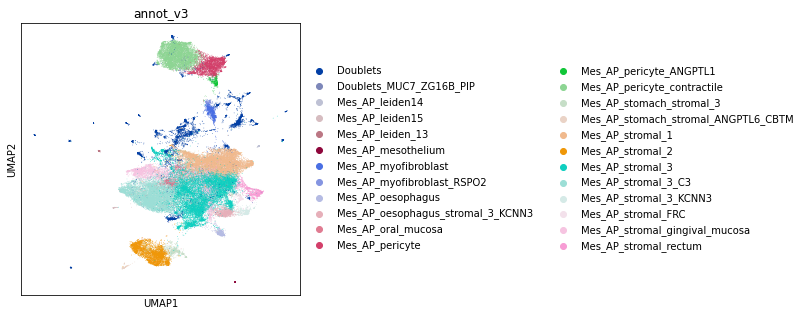

In [241]:
ON = {O:N for O,N in zip(s2.obs_names,s2.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [242]:
doub = adata[adata.obs.annot_v3.isin(['Doublets'])].copy()

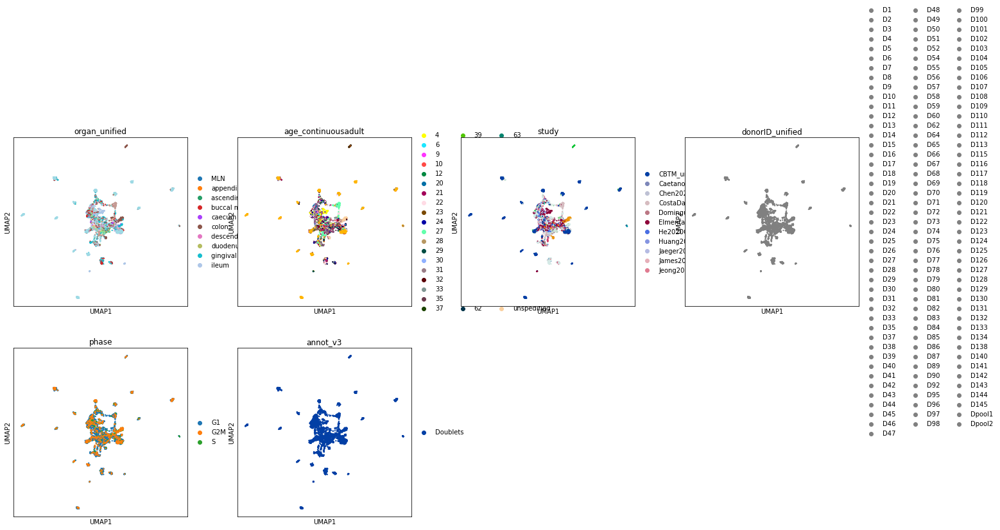

In [243]:
sc.pp.neighbors(
        doub,
            use_rep="X_scvi",
            n_pcs=doub.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(doub, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(doub, color=['organ_unified', 'age_continuousadult','study','donorID_unified','phase','annot_v3'])

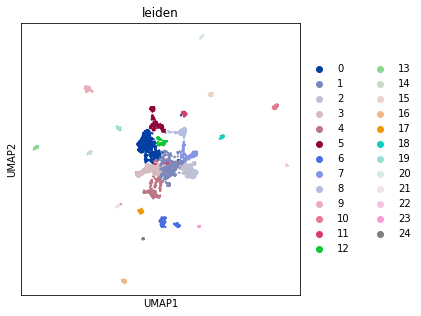

In [247]:
sc.tl.leiden(doub, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(doub, color=['leiden'])

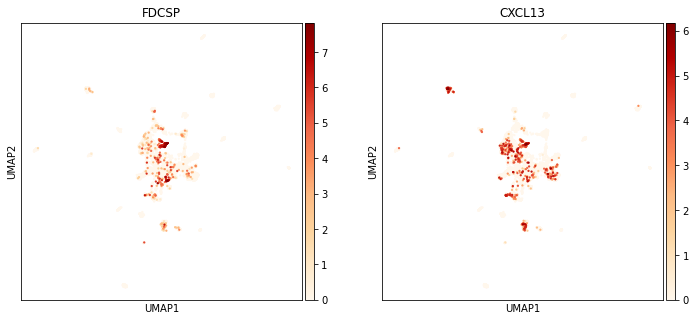

In [248]:
sc.pl.umap(doub,color=['FDCSP','CXCL13'],cmap='OrRd')

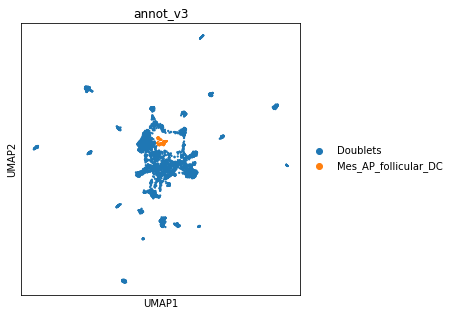

In [249]:
new_cluster_names = [
    'Doublets','Doublets', #0,1
    'Doublets','Doublets',#2,3
    'Doublets','Doublets',#4,5
    'Doublets','Doublets',#6,7
    'Doublets','Doublets',#8,9
    'Doublets','Doublets',#10,11
    'Mes_AP_follicular_DC','Doublets',#12,13
    'Doublets','Doublets',#14,15
    'Doublets','Doublets',#16,17
    'Doublets','Doublets',#18,19
    'Doublets','Doublets',#20,21
    'Doublets','Doublets',#22,23
    'Doublets'
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

doub.obs['annot_v3'] = [conv[x] for x in doub.obs['leiden']]
sc.pl.umap(doub,color='annot_v3')

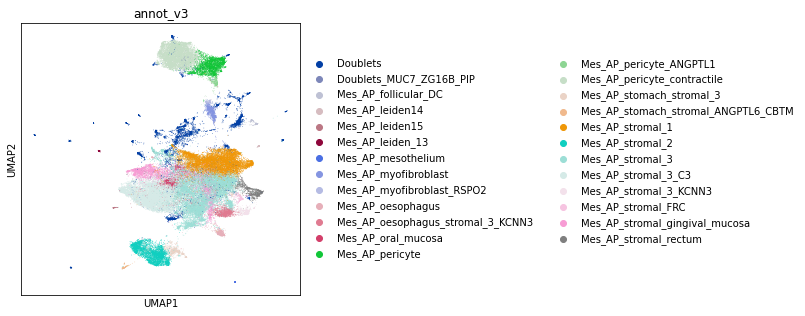

In [250]:
ON = {O:N for O,N in zip(doub.obs_names,doub.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [251]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Mes_AP.hvg5000_noRPL.scvi_output.annotv3.20221201.h5ad')

In [252]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [253]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/Mes_AP_annot_v3_draft.csv')

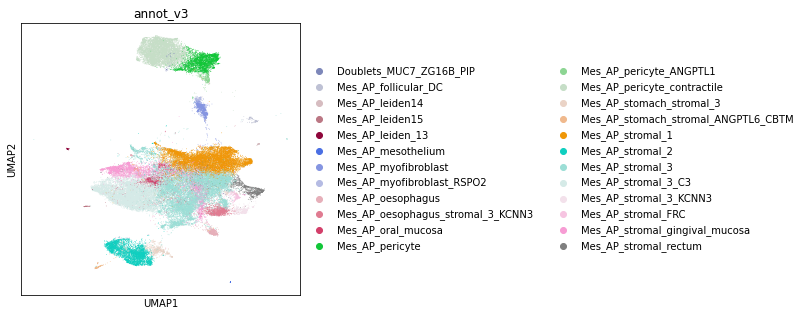

In [254]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [255]:
adata_nodoublets.X.max()

8.750056

In [256]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [257]:
adata_nodoublets.X.max()

3680.0

In [258]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/Mes_AP.raw.annotv3.nodoublets.20221201.h5ad')

In [260]:
adata.var_names[adata.var_names.str.startswith("WNT")]

Index(['WNT4', 'WNT2B', 'WNT9A', 'WNT3A', 'WNT6', 'WNT10A', 'WNT7A', 'WNT5A',
       'WNT5A-AS1', 'WNT8A', 'WNT2', 'WNT16', 'WNT8B', 'WNT11', 'WNT5B',
       'WNT10B', 'WNT1', 'WNT3', 'WNT9B', 'WNT7B'],
      dtype='object')

In [269]:
list(adata.obs.organ_unified.unique())

['gingival mucosa',
 'ileum',
 'stomach',
 'colon',
 'appendix',
 'buccal mucosa',
 'rectum',
 'periodontium',
 'caecum',
 'sigmoid colon',
 'oesophagus',
 'transverse',
 'MLN',
 'ascending colon',
 'salivary gland',
 'descending colon',
 'duodenum',
 'jejunum',
 'small intestine']

In [270]:
adata.obs['organ_unified'].cat.reorder_categories(['periodontium','gingival mucosa','buccal mucosa',
'salivary gland','oesophagus','stomach','duodenum','jejunum','ileum',
'appendix','caecum',
'ascending colon','transverse','descending colon',
'sigmoid colon','rectum','small intestine','colon','MLN'], inplace=True)

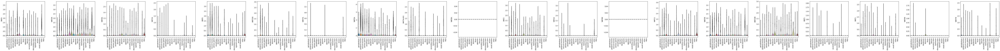

In [271]:
sc.pl.violin(adata,keys=['WNT4', 'WNT2B', 'WNT9A', 'WNT3A', 'WNT6', 'WNT10A', 'WNT7A', 'WNT5A',
       'WNT5A-AS1', 'WNT8A', 'WNT2', 'WNT16', 'WNT8B', 'WNT11', 'WNT5B',
       'WNT10B', 'WNT1', 'WNT3', 'WNT9B', 'WNT7B'],groupby='organ_unified',rotation=90)

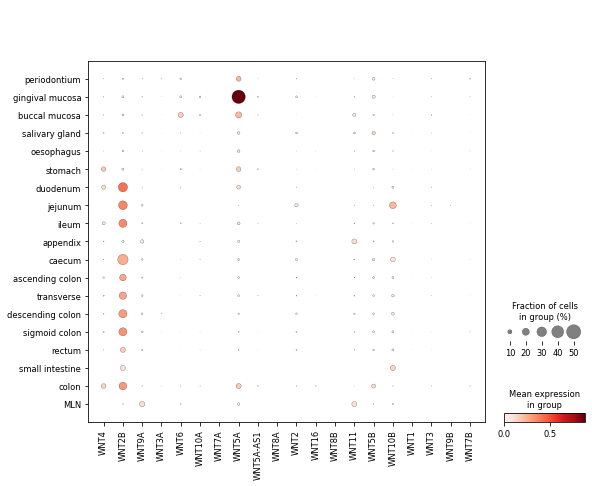

In [272]:
sc.pl.dotplot(adata,var_names=['WNT4', 'WNT2B', 'WNT9A', 'WNT3A', 'WNT6', 'WNT10A', 'WNT7A', 'WNT5A',
       'WNT5A-AS1', 'WNT8A', 'WNT2', 'WNT16', 'WNT8B', 'WNT11', 'WNT5B',
       'WNT10B', 'WNT1', 'WNT3', 'WNT9B', 'WNT7B'],groupby='organ_unified')

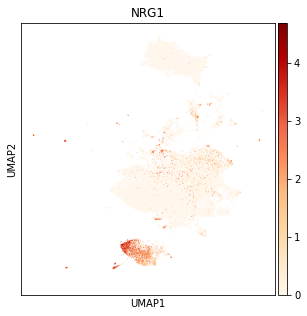

In [274]:
sc.pl.umap(adata,color='NRG1',cmap='OrRd')

## Refining annotations with Rasa

In [56]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Mes_AP.hvg5000_noRPL.scvi_output.annotv3.20221201.h5ad')

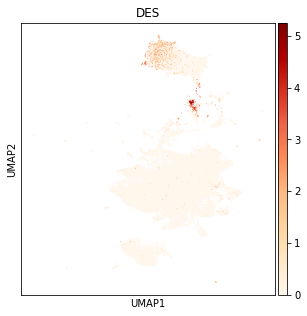

In [4]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='DES',cmap='OrRd')

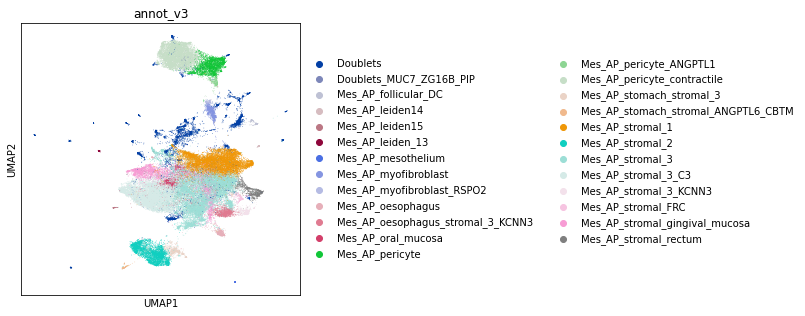

In [6]:
sc.pl.umap(adata,color='annot_v3')

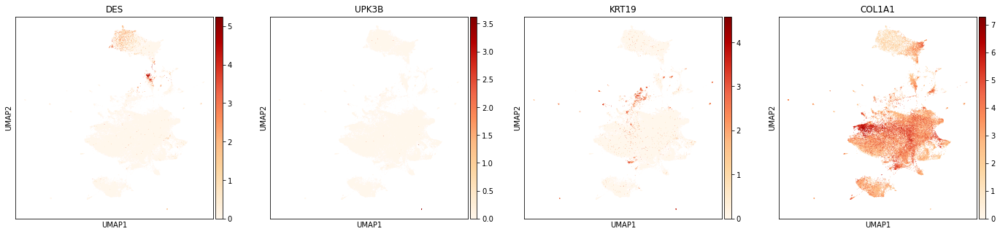

In [11]:
sc.pl.umap(adata,color=['DES','UPK3B','KRT19','COL1A1'],cmap='OrRd')

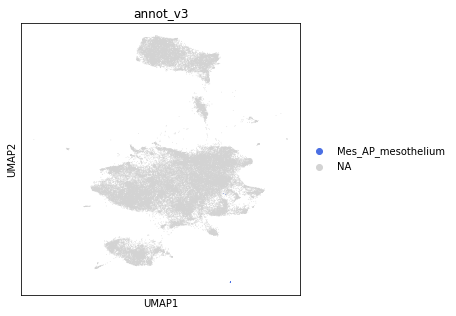

In [10]:
sc.pl.umap(adata_nodoublets,color='annot_v3',groups='Mes_AP_mesothelium')

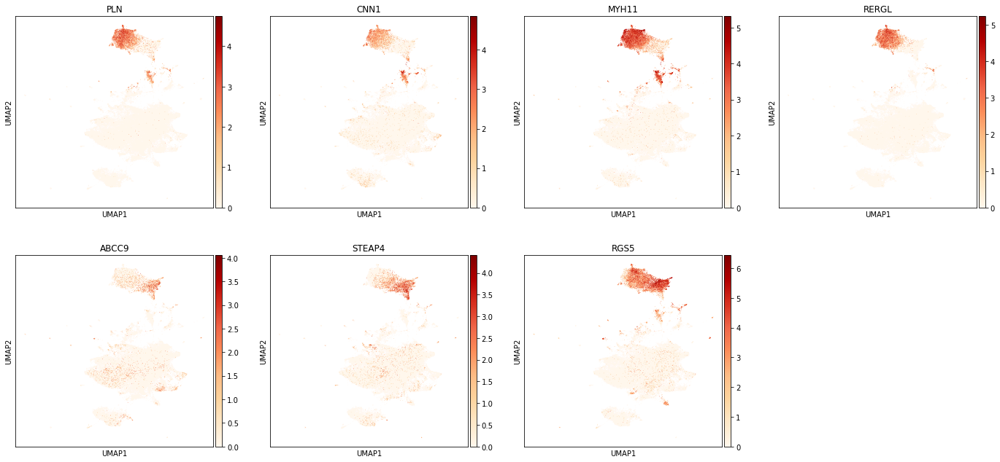

In [14]:
sc.pl.umap(adata,color=['PLN','CNN1','MYH11','RERGL','ABCC9','STEAP4','RGS5'],cmap='OrRd')

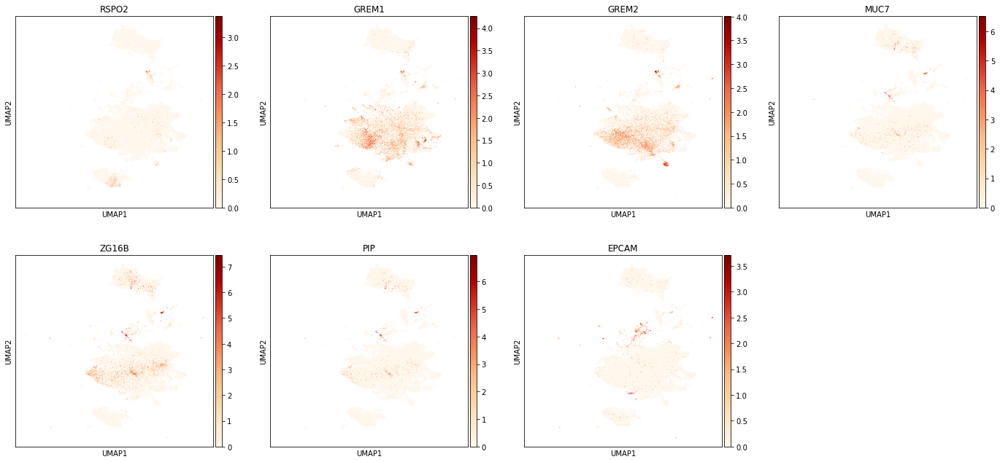

In [18]:
sc.pl.umap(adata,color=['RSPO2','GREM1','GREM2','MUC7','ZG16B','PIP','EPCAM'],cmap='OrRd')

In [16]:
list(adata.obs.annot_v3.unique())

['Mes_AP_stromal_3',
 'Mes_AP_oesophagus',
 'Doublets',
 'Mes_AP_myofibroblast',
 'Mes_AP_pericyte',
 'Mes_AP_stromal_gingival_mucosa',
 'Mes_AP_stromal_1',
 'Mes_AP_stromal_3_KCNN3',
 'Mes_AP_oral_mucosa',
 'Mes_AP_stomach_stromal_ANGPTL6_CBTM',
 'Mes_AP_pericyte_contractile',
 'Mes_AP_stromal_3_C3',
 'Mes_AP_stromal_2',
 'Mes_AP_stromal_rectum',
 'Mes_AP_stomach_stromal_3',
 'Mes_AP_stromal_FRC',
 'Mes_AP_oesophagus_stromal_3_KCNN3',
 'Mes_AP_myofibroblast_RSPO2',
 'Mes_AP_pericyte_ANGPTL1',
 'Mes_AP_leiden14',
 'Mes_AP_leiden_13',
 'Doublets_MUC7_ZG16B_PIP',
 'Mes_AP_leiden15',
 'Mes_AP_follicular_DC',
 'Mes_AP_mesothelium']

In [57]:
#rename cell types

adata.obs['annot_v3_clean'] = (
    adata.obs["annot_v3"]
    .map(lambda x: {'Mes_AP_myofibroblast_RSPO2':'Mes_AP_myofibroblast',
                    'Mes_AP_pericyte_contractile':'Mes_AP_vascular_smooth_muscle',
                    
                    'Mes_AP_leiden14':'Doublets',
                    'Mes_AP_leiden_13':'Doublets',
                    'Doublets_MUC7_ZG16B_PIP':'Doublets',
                    'Mes_AP_leiden15':'Doublets',
                    'Mes_AP_stomach_stromal_ANGPTL6_CBTM':'Doublets', #donor with poor quality cells, exclude
                    'Mes_AP_stromal_FRC':'Mes_AP_stromal_fibroblast_reticular',
                    'Mes_AP_stomach_stromal_3':'Mes_AP_stomach_stromal_2'
                    
                    
                    
                    
    }.get(x, x))
    .astype("category")
)

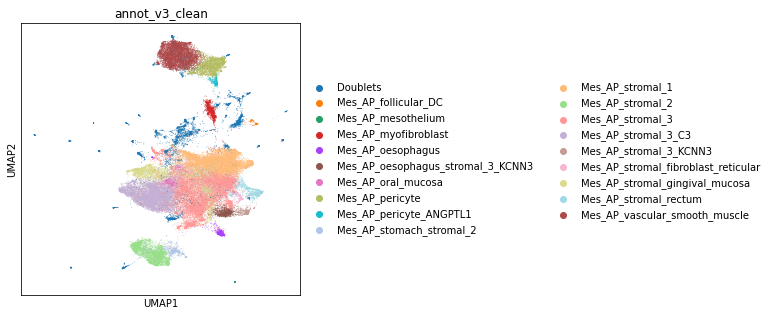

In [37]:
sc.pl.umap(adata,color='annot_v3_clean')

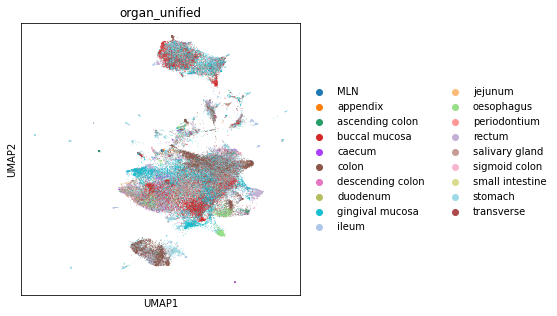

In [26]:
sc.pl.umap(adata,color='organ_unified')

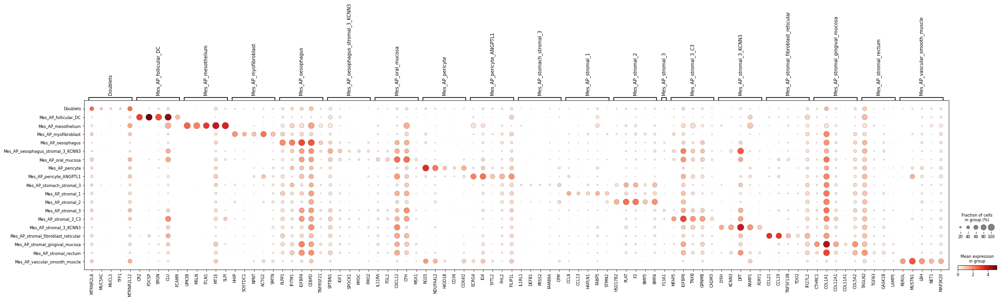

In [28]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="annot_v3_clean")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='annot_v3_clean', mks=mks)

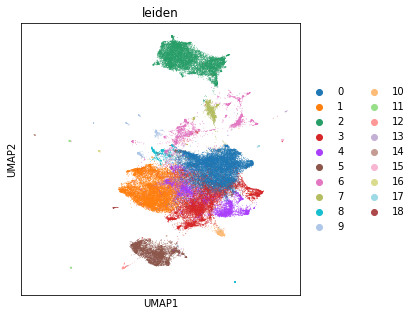

In [29]:
sc.pl.umap(adata,color='leiden')

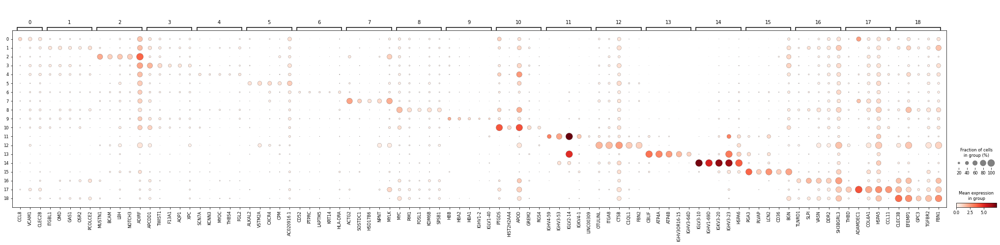

In [30]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden', mks=mks)

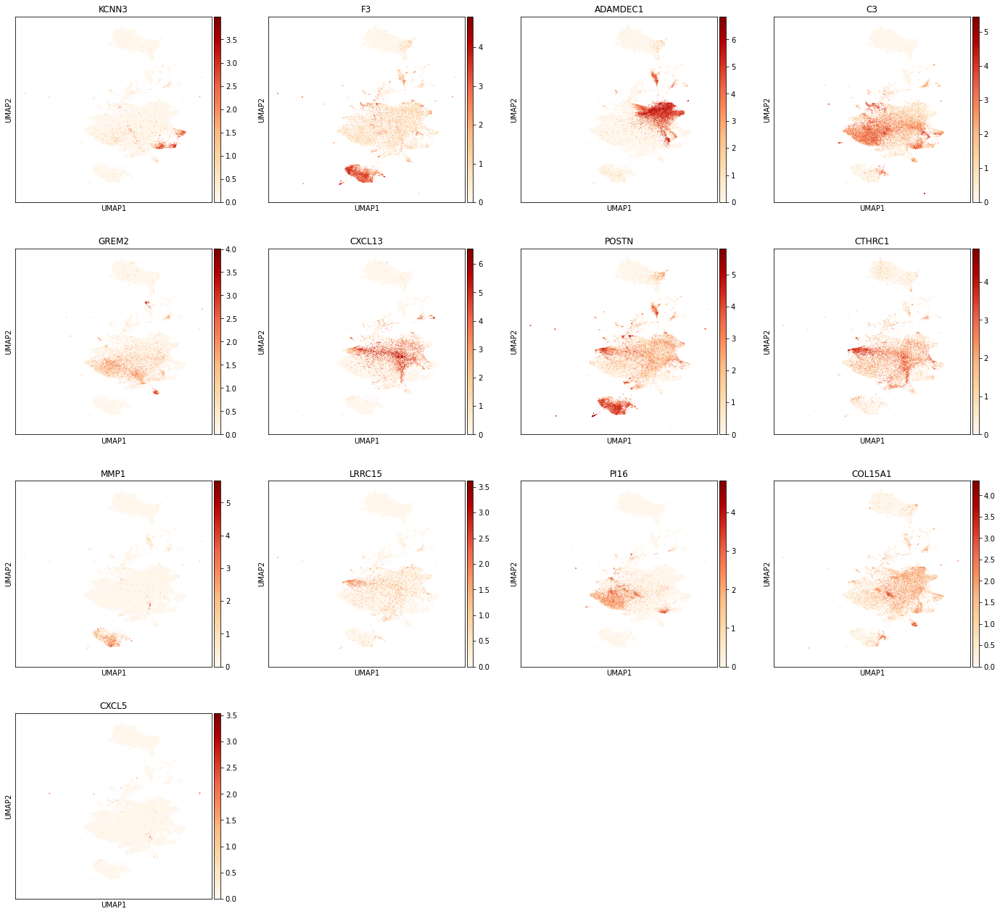

In [40]:
sc.pl.umap(adata,color=['KCNN3','F3','ADAMDEC1','C3','GREM2','CXCL13','POSTN','CTHRC1','MMP1','LRRC15','PI16','COL15A1','CXCL5'],cmap='OrRd')

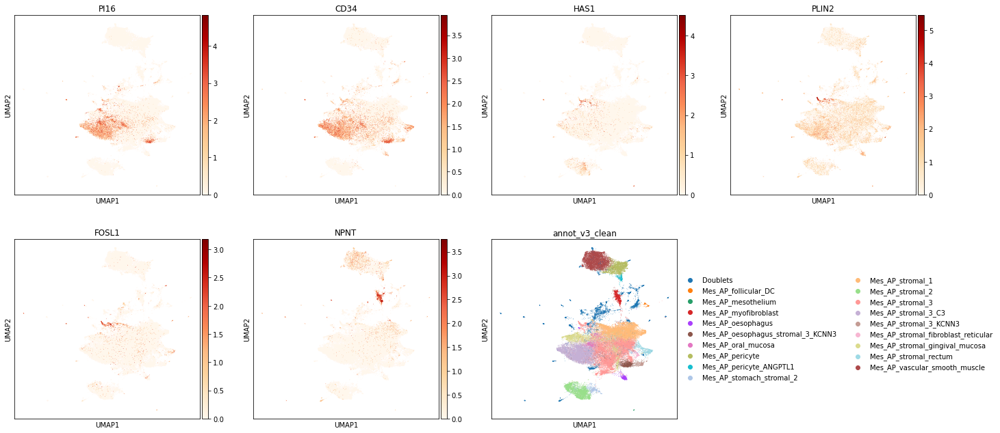

In [49]:
sc.pl.umap(adata,color=['PI16','CD34','HAS1','PLIN2','FOSL1','NPNT','annot_v3_clean'],cmap='OrRd')

In [48]:
pd.crosstab(adata.obs.study,adata.obs.leiden)

leiden,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18
study,,,,,,,,,,,,,,,,,,,
CBTM_unpublished,240,152,390,467,164,247,524,338,6,209,43,242,175,117,119,99,0,69,66
Caetano2021,90,101,400,131,56,5,12,0,1,5,0,0,0,0,0,0,0,0,0
Chen2021,14,19,2,1,22,0,37,0,35,0,0,0,0,0,0,0,0,0,0
CostaDaSilva2022,836,1115,494,210,610,7,324,2,4,19,1,0,0,0,0,0,0,0,0
Dominguez2022,5,24,1,2,1,0,32,0,1,1,0,0,0,0,0,0,0,0,0
Elmentaite2021,2451,2676,931,337,668,623,601,312,466,60,0,0,0,0,0,0,101,0,0
He2020GenomeBio,244,1117,301,695,892,45,142,10,98,7,563,0,0,0,0,1,0,0,0
Huang2019,0,7,1,4,0,0,24,1,0,0,0,0,0,0,0,0,0,0,0
Jaeger2021,0,2,0,0,0,0,57,0,0,0,0,0,0,0,0,0,0,0,0


In [45]:
list(adata.obs.annot_v3_clean.unique())

['Mes_AP_stromal_3',
 'Mes_AP_oesophagus',
 'Doublets',
 'Mes_AP_myofibroblast',
 'Mes_AP_pericyte',
 'Mes_AP_stromal_gingival_mucosa',
 'Mes_AP_stromal_1',
 'Mes_AP_stromal_3_KCNN3',
 'Mes_AP_oral_mucosa',
 'Mes_AP_vascular_smooth_muscle',
 'Mes_AP_stromal_3_C3',
 'Mes_AP_stromal_2',
 'Mes_AP_stromal_rectum',
 'Mes_AP_stomach_stromal_2',
 'Mes_AP_stromal_fibroblast_reticular',
 'Mes_AP_oesophagus_stromal_3_KCNN3',
 'Mes_AP_pericyte_ANGPTL1',
 'Mes_AP_follicular_DC',
 'Mes_AP_mesothelium']

ValueError: Invalid RGBA argument: nan

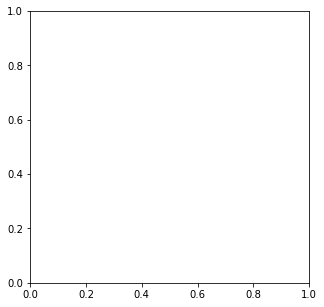

In [50]:
sc.pl.umap(adata,color='donorID_unified',groups=['D54',
'D55',
'D56',
'D57',
'D58',
'D59',
'D60'])

## harmonising names with other studies/across tissues
#https://www.nature.com/articles/s41586-021-03549-5
#https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7530522/


adata.obs['annot_v3_clean'] = (
    adata.obs["annot_v3_clean"]
    .map(lambda x: {'Mes_AP_stromal_3_C3':'Mes_AP_crypt_fibroblast_PI16',
                    'Mes_AP_stromal_gingival_mucosa':'Mes_AP_crypt_fibroblast_PI16',
                    'Mes_AP_oesophagus_stromal_3_KCNN3':'Mes_AP_crypt_fibroblast_PI16',
                    'Mes_AP_oral_mucosa':'Mes_AP_crypt_fibroblast_PI16',
                    'Mes_AP_stromal_3_KCNN3':'Mes_AP_crypt_fibroblast_PI16',
                    
                    
                    'Mes_AP_stomach_stromal_2':'Mes_AP_villus_fibroblast_F3',
                    
                    'Mes_AP_stromal_1':'Mes_AP_lamina_propria_fibroblast_ADAMDEC1'
                    
                    
                    
                    
                    
                    
                    
                    
                    
                    
    }.get(x, x))
    .astype("category")
)

#leiden cluster 8 need to call it as something because it is separate (eg. FOSL1, other marker genes HAS1, PLIN2)

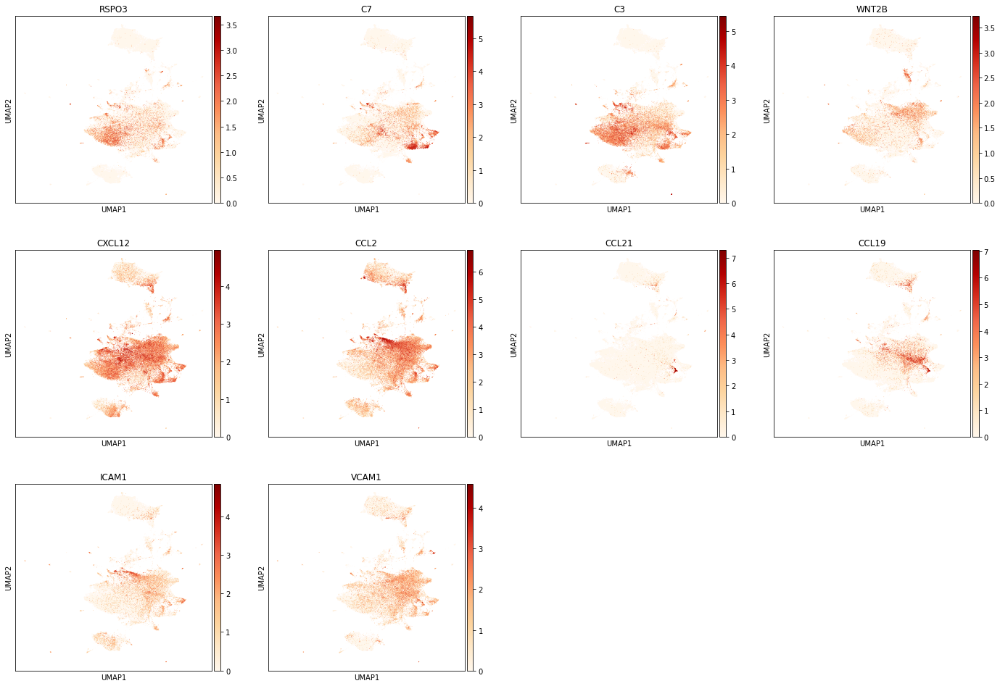

In [63]:
sc.pl.umap(adata,color=['RSPO3','C7','C3','WNT2B',
                        "CXCL12", "CCL2", "CCL21", "CCL19", "ICAM1", "VCAM1"],cmap='OrRd')

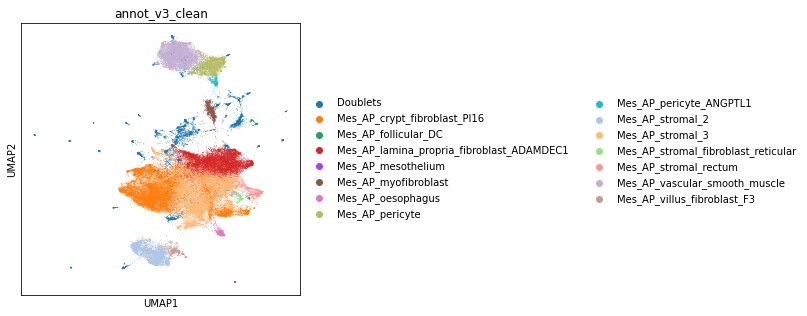

In [59]:
sc.pl.umap(adata,color='annot_v3_clean')

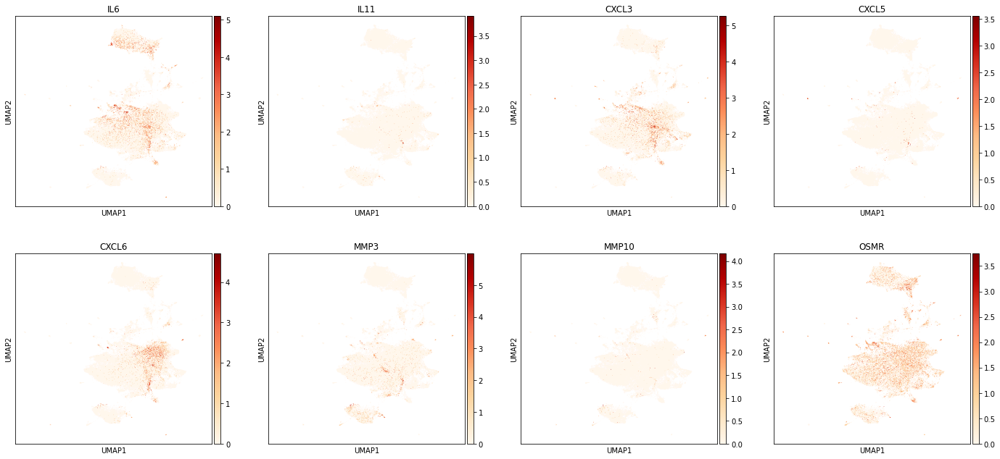

In [61]:
sc.pl.umap(adata,color=['IL6','IL11','CXCL3','CXCL5','CXCL6','MMP3','MMP10','OSMR'],cmap='OrRd')

In [65]:
zero = adata[adata.obs.leiden.isin(['0'])]

In [66]:
zero.obs['annot_v3_clean'] = (
    zero.obs["leiden"]
    .map(lambda x: {'0':'Mes_AP_lamina_propria_fibroblast_ADAMDEC1'}.get(x, x))
    .astype("category")
)

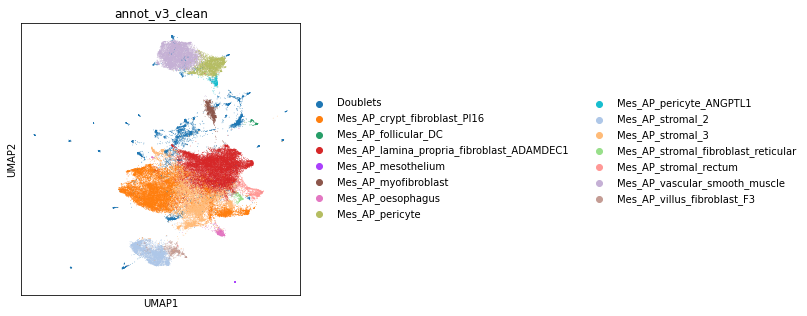

In [67]:
ON = {O:N for O,N in zip(zero.obs_names,zero.obs["annot_v3_clean"])}
adata.obs["annot_v3_clean"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3_clean"])]
sc.pl.umap(adata,color='annot_v3_clean')

In [ ]:
ON = {O:N for O,N in zip(zero.obs_names,zero.obs["annot_v3_clean"])}
adata.obs["annot_v3_clean"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3_clean"])]
sc.pl.umap(adata,color='annot_v3_clean')

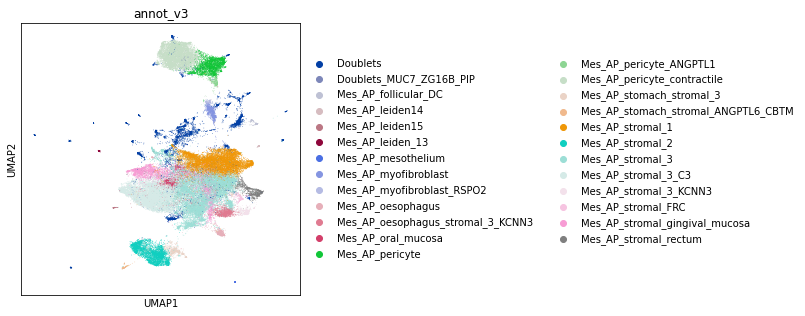

In [73]:
sc.pl.umap(adata,color='annot_v3')

In [74]:
adata.obs.annot_v3.value_counts()

Mes_AP_stromal_3                       14354
Mes_AP_stromal_1                        9396
Mes_AP_stromal_3_C3                     8741
Mes_AP_pericyte_contractile             6757
Doublets                                5805
Mes_AP_stromal_gingival_mucosa          4378
Mes_AP_stromal_2                        4082
Mes_AP_pericyte                         3025
Mes_AP_oesophagus_stromal_3_KCNN3       1447
Mes_AP_stromal_rectum                   1406
Mes_AP_myofibroblast                    1062
Mes_AP_stomach_stromal_3                 927
Mes_AP_oral_mucosa                       902
Mes_AP_oesophagus                        716
Mes_AP_stromal_3_KCNN3                   499
Mes_AP_pericyte_ANGPTL1                  363
Mes_AP_stromal_FRC                       300
Mes_AP_myofibroblast_RSPO2               183
Mes_AP_stomach_stromal_ANGPTL6_CBTM      183
Mes_AP_follicular_DC                     135
Mes_AP_leiden_13                         104
Mes_AP_leiden14                           70
Mes_AP_lei

In [75]:
gm = adata[adata.obs.annot_v3.isin(['Mes_AP_stromal_gingival_mucosa'])]

In [76]:
gm

View of AnnData object with n_obs × n_vars = 4378 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts

In [77]:
gm.obs['annot_v3_clean'] = (
    gm.obs["annot_v3"]
    .map(lambda x: {'Mes_AP_stromal_gingival_mucosa':'Mes_AP_gingival_mucosa_fibroblast'}.get(x, x))
    .astype("category")
)

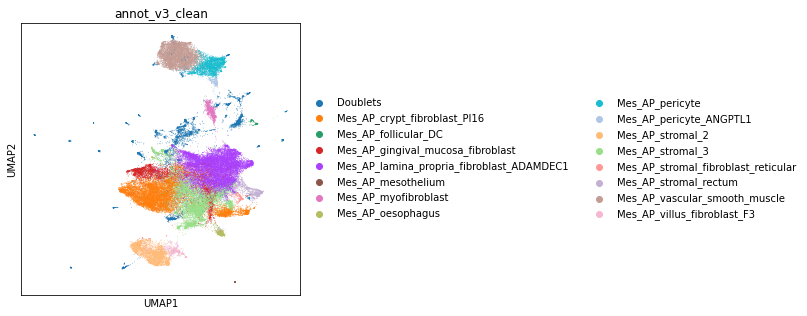

In [78]:
ON = {O:N for O,N in zip(gm.obs_names,gm.obs["annot_v3_clean"])}
adata.obs["annot_v3_clean"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3_clean"])]
sc.pl.umap(adata,color='annot_v3_clean')

In [79]:
adata.obs['annot_v3_clean'] = (
    adata.obs["annot_v3_clean"]
    .map(lambda x: {'Mes_AP_oesophagus':'Mes_AP_oesophagus_fibroblast',
                    'Mes_AP_stromal_2':'Mes_AP_villus_fibroblast_F3',
                    'Mes_AP_stromal_3':'Mes_AP_crypt_fibroblast_PI16',
                    'Mes_AP_stromal_rectum':'Mes_AP_rectum_fibroblast',
                    'Mes_AP_pericyte_ANGPTL1':'Mes_AP_immune_recruiting_pericyte',
                    
   }.get(x, x))
    .astype("category")
)

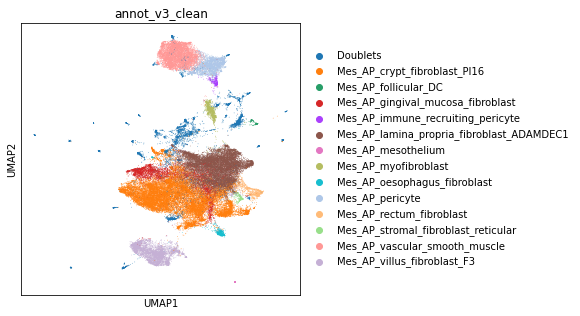

In [80]:
sc.pl.umap(adata,color='annot_v3_clean')

In [81]:
adata.obs['annot_v3_clean'] = (
    adata.obs["annot_v3_clean"]
    .map(lambda x: {'Mes_AP_gingival_mucosa_fibroblast':'Mes_AP_oral_mucosa_fibroblast'
                    
   }.get(x, x))
    .astype("category")
)

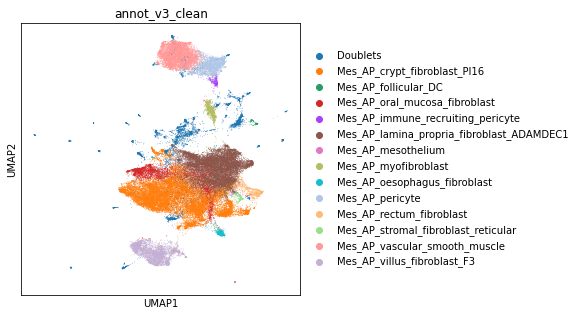

In [82]:
sc.pl.umap(adata,color='annot_v3_clean')

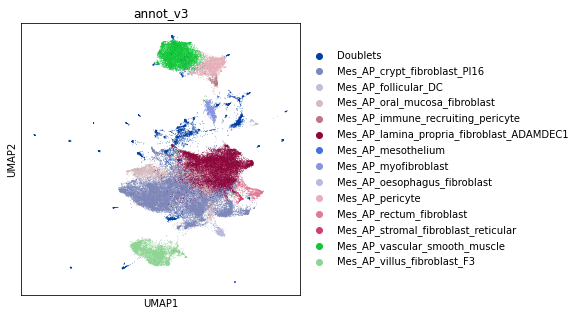

In [83]:
adata.obs['annot_v3'] = adata.obs['annot_v3_clean']
sc.pl.umap(adata,color='annot_v3')

In [84]:
del adata.obs['annot_v3_clean']

In [94]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Mes_AP.hvg5000_noRPL.scvi_output.annotv3.20221206.h5ad')

In [87]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [95]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/Mes_AP_annot_v3_new.csv')

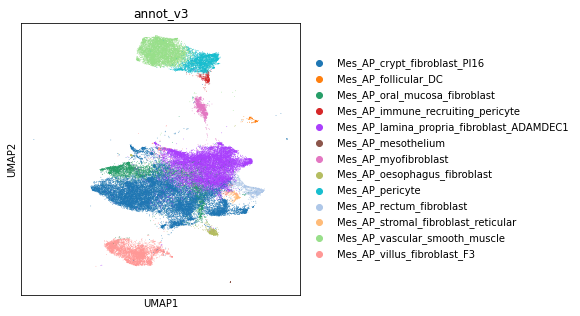

In [89]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [90]:
adata_nodoublets.X.max()

8.750056

In [91]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [92]:
adata_nodoublets.X.max()

3680.0

In [93]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/Mes_AP.raw.annotv3.nodoublets.22021206.h5ad')

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Mes_AP.hvg5000_noRPL.scvi_output.annotv3.20221206.h5ad')

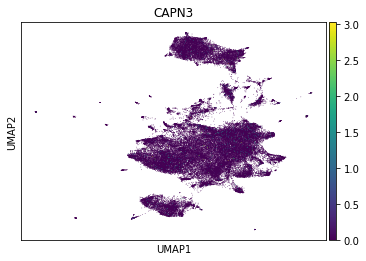

In [3]:
sc.pl.umap(adata,color='CAPN3')

## Refine annotations after doublet removal and reintegration scvi

In [3]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/no_doublets/Mes_AP.hvg5000_noCC.scvi_output.annotv3.nodoublets.22021208.h5ad')

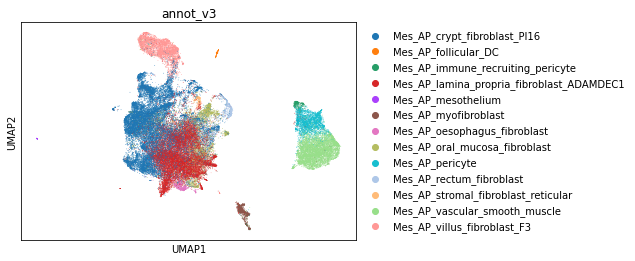

In [4]:
sc.pl.umap(adata,color='annot_v3')

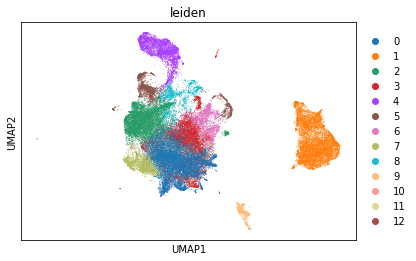

In [5]:
sc.tl.leiden(adata, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(adata, color=['leiden'])

Keep annotations as is?

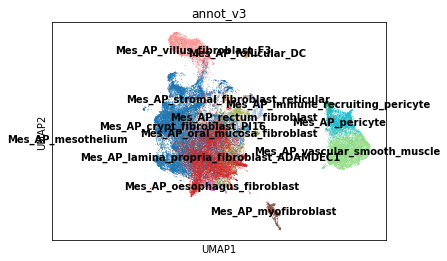

In [6]:
sc.pl.umap(adata,color='annot_v3',legend_loc='on data')

## Plots for figures

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/no_doublets/Mes_AP.hvg5000_noCC.scvi_output.annotv3.nodoublets.22021208.h5ad')

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


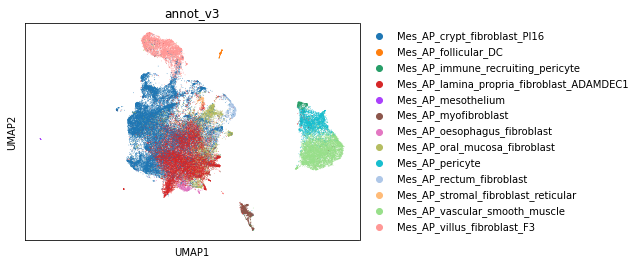

In [3]:
sc.pl.umap(adata,color='annot_v3')

In [4]:
adata.obs['fine_annot'] = adata.obs["annot_v3"].str.replace("Mes_AP_","")

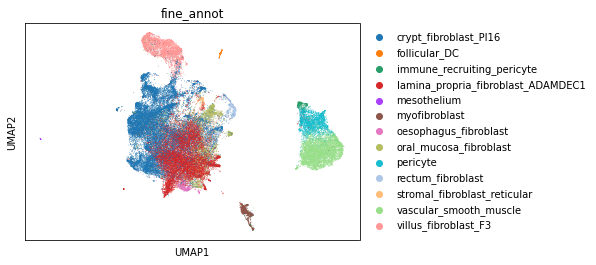

In [5]:
sc.pl.umap(adata,color='fine_annot')

In [6]:
list(adata.obs.fine_annot.unique())

['lamina_propria_fibroblast_ADAMDEC1',
 'oesophagus_fibroblast',
 'myofibroblast',
 'pericyte',
 'oral_mucosa_fibroblast',
 'crypt_fibroblast_PI16',
 'vascular_smooth_muscle',
 'villus_fibroblast_F3',
 'stromal_fibroblast_reticular',
 'rectum_fibroblast',
 'immune_recruiting_pericyte',
 'follicular_DC',
 'mesothelium']

In [7]:
adata.obs['fine_annot'] = (
    adata.obs["fine_annot"]
    .map(lambda x: {
        'lamina_propria_fibroblast_ADAMDEC1':'Lamina_propria_fibroblast_ADAMDEC1',
 'oesophagus_fibroblast':'Oesophagus_fibroblast',
 'myofibroblast':'Myofibroblast',
 'pericyte':'Pericyte',
 'oral_mucosa_fibroblast':'Oral_mucosa_fibroblast',
 'crypt_fibroblast_PI16':'Crypt_fibroblast_PI16',
 'vascular_smooth_muscle':'Vascular_smooth_muscle',
 'villus_fibroblast_F3':'Villus_fibroblast_F3',
 'stromal_fibroblast_reticular':'Stromal_fibroblast_reticular',
 'rectum_fibroblast':'Rectum_fibroblast',
 'immune_recruiting_pericyte':'Immune_recruiting_pericyte',
 'follicular_DC':'Follicular_DC',
 'mesothelium':'Mesothelium'
        
        
         }.get(x, x))
    .astype("category")
)

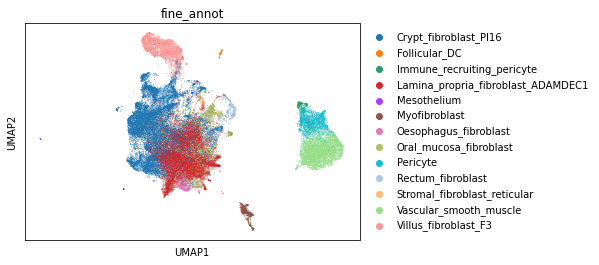

In [8]:
sc.pl.umap(adata,color='fine_annot')

In [9]:
adata.obs.fine_annot.cat.categories

Index(['Crypt_fibroblast_PI16', 'Follicular_DC', 'Immune_recruiting_pericyte',
       'Lamina_propria_fibroblast_ADAMDEC1', 'Mesothelium', 'Myofibroblast',
       'Oesophagus_fibroblast', 'Oral_mucosa_fibroblast', 'Pericyte',
       'Rectum_fibroblast', 'Stromal_fibroblast_reticular',
       'Vascular_smooth_muscle', 'Villus_fibroblast_F3'],
      dtype='object')

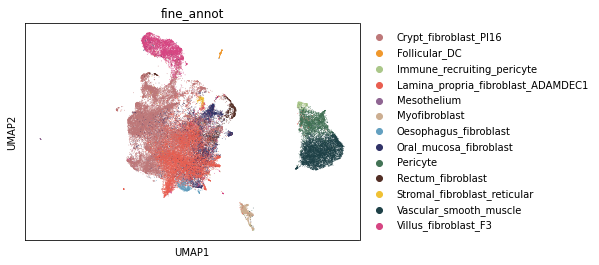

In [10]:
sc.pl.umap(adata,color='fine_annot',palette = ['#bd7879',#'Crypt_fibroblast_PI16', 
           '#f0982c',#'Follicular_DC', 
           '#AAC789',#'Immune_recruiting_pericyte',
           '#e95e50',#'Lamina_propria_fibroblast_ADAMDEC1', 
           '#8F6592',#'Mesothelium', 
           '#CCAE91',#'Myofibroblast',
           '#63A0C0',#'Oesophagus_fibroblast', 
           '#303267',#'Oral_mucosa_fibroblast', 
           '#437356',#'Pericyte',
           '#522e25',#'Rectum_fibroblast',
           '#f0c134',#'Stromal_fibroblast_reticular',
           '#1E4147',#'Vascular_smooth_muscle',
           '#d64582'#'Villus_fibroblast_F3'
                                              ])

In [11]:
#save raw counts in layers
adata.layers['counts'] = adata.X
#normalise and transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

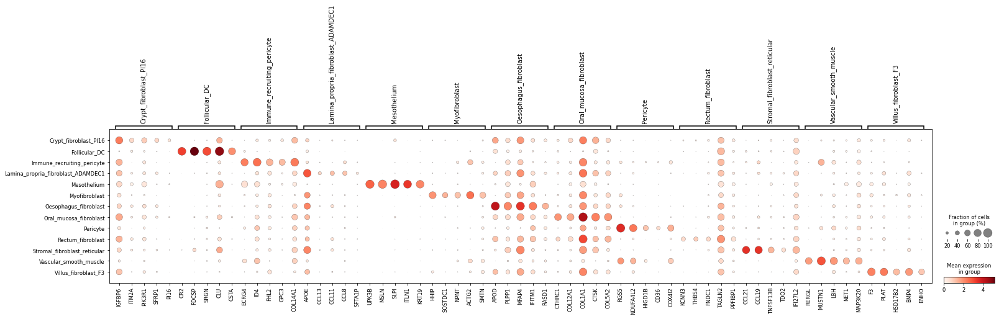

In [12]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="fine_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='fine_annot', mks=mks)

In [13]:
list(adata.obs.fine_annot.unique())

['Lamina_propria_fibroblast_ADAMDEC1',
 'Oesophagus_fibroblast',
 'Myofibroblast',
 'Pericyte',
 'Oral_mucosa_fibroblast',
 'Crypt_fibroblast_PI16',
 'Vascular_smooth_muscle',
 'Villus_fibroblast_F3',
 'Stromal_fibroblast_reticular',
 'Rectum_fibroblast',
 'Immune_recruiting_pericyte',
 'Follicular_DC',
 'Mesothelium']

In [14]:
marker_genes_dict = {'General fibroblast markers':['VCAN', 'PDGFRA'],
                     'General smooth muscle/pericyte markers':['TAGLN', 'ACTA2','TPM2', 'MYH11'],
                     'Crypt_fibroblast_PI16':['PI16','RSPO3','SFRP1','ITM2A'],
                     'Follicular_DC':['FDCSP','SRGN','CR2','CLU','CSTA'],
                     'Immune_recruiting_pericyte':['GPC3','COL14A1','ECRG4','ID4','FHL2','CXCL12'],
                     'Lamina_propria_fibroblast_ADAMDEC1':['ADAMDEC1','CXCL14','ADAM28','CCL11','CCL8','CCL13','CFD'],
                     'Mesothelium':['UPK3B','MSLN','SLPI','KRT19'],
                     'Myofibroblast':['ACTG2','HHIP','SOSTDC1','NPNT'],
                     'Oesophagus_fibroblast':['APOD','PLPP1','MFAP4','IFITM1','RASD1'],
                     'Oral_mucosa_fibroblast':['CTHRC1','COL12A1','COL1A1','CTSK','COL5A2'],
                     'Pericyte':['CD36','COX4I2','HIGD1B','RGS5','NDUFA4L2'],
                     'Rectum_fibroblast':['KCNN3','THBS4','FNDC1','PPFIBP1'],
                     'Stromal_fibroblast_retictular':['CCL21','CCL19','TNFSF13B','TDO2'],
                     'Vascular_smooth_muscle':['RERGL','MUSTN1','LBH','NET1','MAP3K20'],
                     'Villus_fibroblast_F3':['F3','PLAT','HSD17B2','SOX6']
    
                    }

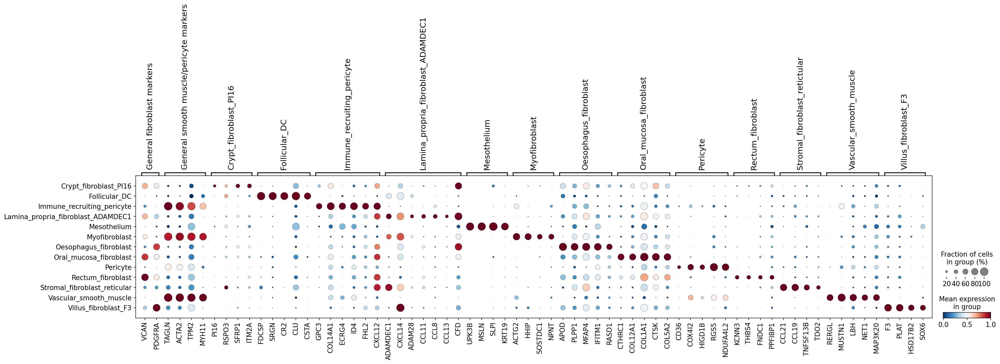

In [15]:
sc.set_figure_params(dpi_save = 300)
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_annot',save='Mes_markers.png',color_map='RdBu_r', standard_scale='var')

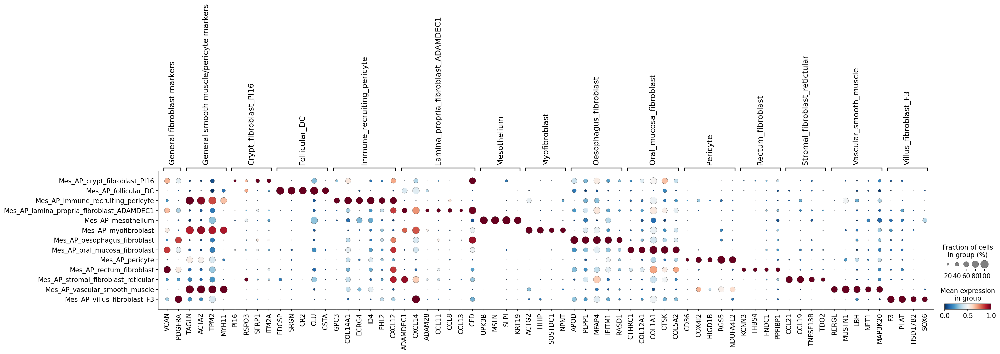

In [16]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='annot_v3',save='Mes_AP_markers.pdf',color_map='RdBu_r', standard_scale='var')

In [17]:
adata.obs.fine_annot.cat.categories

Index(['Crypt_fibroblast_PI16', 'Follicular_DC', 'Immune_recruiting_pericyte',
       'Lamina_propria_fibroblast_ADAMDEC1', 'Mesothelium', 'Myofibroblast',
       'Oesophagus_fibroblast', 'Oral_mucosa_fibroblast', 'Pericyte',
       'Rectum_fibroblast', 'Stromal_fibroblast_reticular',
       'Vascular_smooth_muscle', 'Villus_fibroblast_F3'],
      dtype='object')

In [18]:
adata.obs['fine_annot'].cat.reorder_categories([
    
    
    'Vascular_smooth_muscle','Pericyte','Immune_recruiting_pericyte',
    'Myofibroblast','Follicular_DC','Stromal_fibroblast_reticular',
    'Villus_fibroblast_F3', 'Crypt_fibroblast_PI16',  
       'Lamina_propria_fibroblast_ADAMDEC1',
       'Oesophagus_fibroblast', 'Oral_mucosa_fibroblast', 
       'Rectum_fibroblast', 
        'Mesothelium' ], inplace=True)

In [19]:
marker_genes_dict = {'General Mesenchyme markers':['VIM','DCN'],
                     'General fibroblast markers':['VCAN','PDGFRA'],
                     'General smooth muscle/pericyte markers':['TAGLN', 'ACTA2','TPM2', 'MYH11'],
                     'Vascular_smooth_muscle':['RERGL','MUSTN1','LBH','NET1','MAP3K20'],
                     'Pericyte':['CD36','COX4I2','HIGD1B','RGS5','NDUFA4L2'],
                     'Immune_recruiting_pericyte':['GPC3','COL14A1','ECRG4','ID4','FHL2','CXCL12'],
                     'Myofibroblast':['ACTG2','HHIP','SOSTDC1','NPNT'],
                     'Follicular_DC':['FDCSP','SRGN','CR2','CLU','CSTA'],
                     'Stromal_fibroblast_retictular':['CCL21','CCL19','TNFSF13B','TDO2'],
                     'Villus_fibroblast_F3':['F3','PLAT','HSD17B2','SOX6'],
                     'Crypt_fibroblast_PI16':['PI16','RSPO3','SFRP1','ITM2A'],
                     
                     
                     'Lamina_propria_fibroblast_ADAMDEC1':['ADAMDEC1','ADAM28','CCL11','CCL8','CCL13','CFD'],
                     
                     
                     'Oesophagus_fibroblast':['APOD','PLPP1','MFAP4','IFITM1','RASD1'],
                     'Oral_mucosa_fibroblast':['CTHRC1','COL12A1','COL1A1','CTSK','COL5A2'],
                     
                     'Rectum_fibroblast':['KCNN3','THBS4','FNDC1','PPFIBP1'],
                     'Mesothelium':['UPK3B','MSLN','SLPI','KRT19']
                     
                     
                     
    
                    }

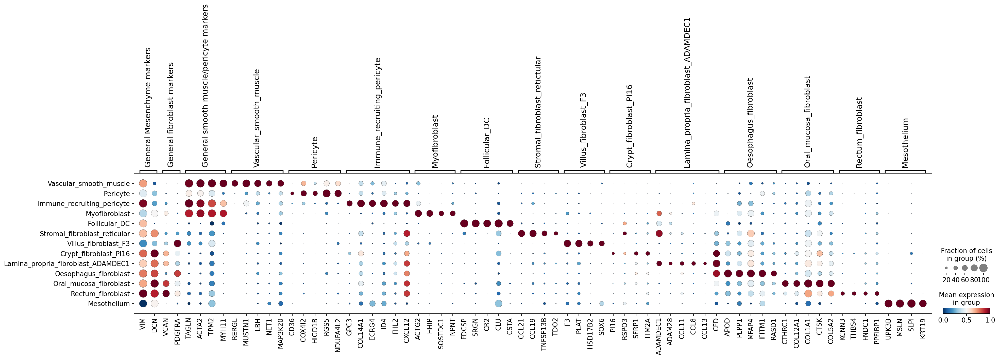

In [20]:
sc.set_figure_params(dpi_save = 300)
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_annot',save='Mes_markers.png',color_map='RdBu_r', standard_scale='var')

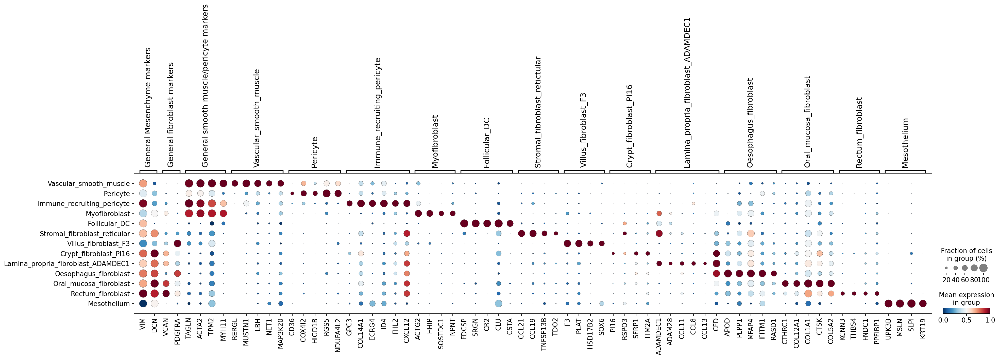

In [21]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_annot',save='Mes_AP_markers.pdf',color_map='RdBu_r', standard_scale='var')

In [22]:
fibroblast_markers = {'S1':['ADAMDEC1','CXCL14','CTSC','ADAM28','EDIL3','CCL11','FABP5','EMILIN1','RBP1'],
                     'S2':['CXCL14','F3','PDGFRA','SOX6','EDNRB','ALKAL2','TRPA1','APOD','NBL1','F2R'],
                     'S3':['MGP','CCDC80','DPT','C7','OGN','FBLN1','GREM1','IGF1','DCN','SFRP2'],
                     'S3x':['PLAC9','DCN','CFD','MGP','S100A4','GSN','IGFBP6','TNXB','S100A10','MFAP5'],
                     'S4':['CCL19','PTGDS','CCL21','CD74','C3','TNFSF13B','CTSH','APOE','CLU','C7'],
                     'S5':['FTH1','MT2A','CXCL5','MMP1','SAT1','MT1E']}

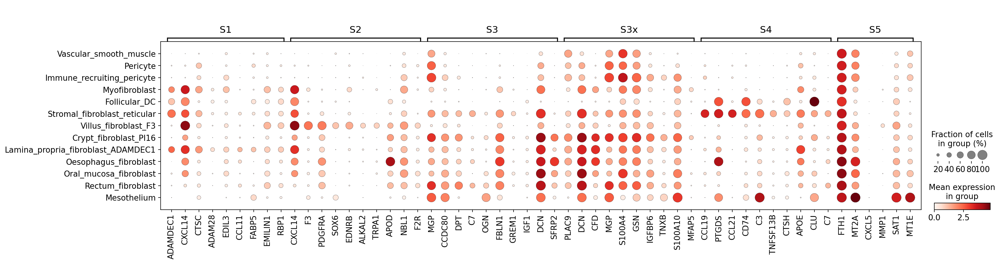

In [23]:
sc.pl.dotplot(adata,var_names=fibroblast_markers,groupby='fine_annot')

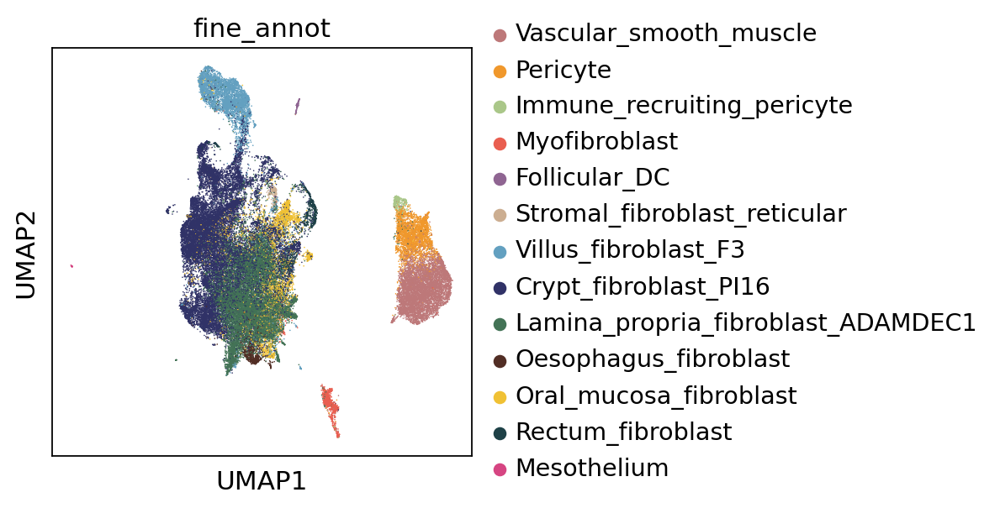

In [24]:
sc.pl.umap(adata,color='fine_annot')

In [25]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=300,dpi_save=600)

In [26]:
list(adata.obs.fine_annot.unique())

['Lamina_propria_fibroblast_ADAMDEC1',
 'Oesophagus_fibroblast',
 'Myofibroblast',
 'Pericyte',
 'Oral_mucosa_fibroblast',
 'Crypt_fibroblast_PI16',
 'Vascular_smooth_muscle',
 'Villus_fibroblast_F3',
 'Stromal_fibroblast_reticular',
 'Rectum_fibroblast',
 'Immune_recruiting_pericyte',
 'Follicular_DC',
 'Mesothelium']

In [27]:
adata.obs['fine_annot'].cat.reorder_categories([
     'Vascular_smooth_muscle',
    'Pericyte',
    'Immune_recruiting_pericyte',
     'Myofibroblast',
     'Follicular_DC',
     'Stromal_fibroblast_reticular',
     'Villus_fibroblast_F3',
     'Crypt_fibroblast_PI16',
    'Lamina_propria_fibroblast_ADAMDEC1',
 'Oesophagus_fibroblast',

 
 'Oral_mucosa_fibroblast',




 'Rectum_fibroblast',
 

 'Mesothelium'], inplace=True)

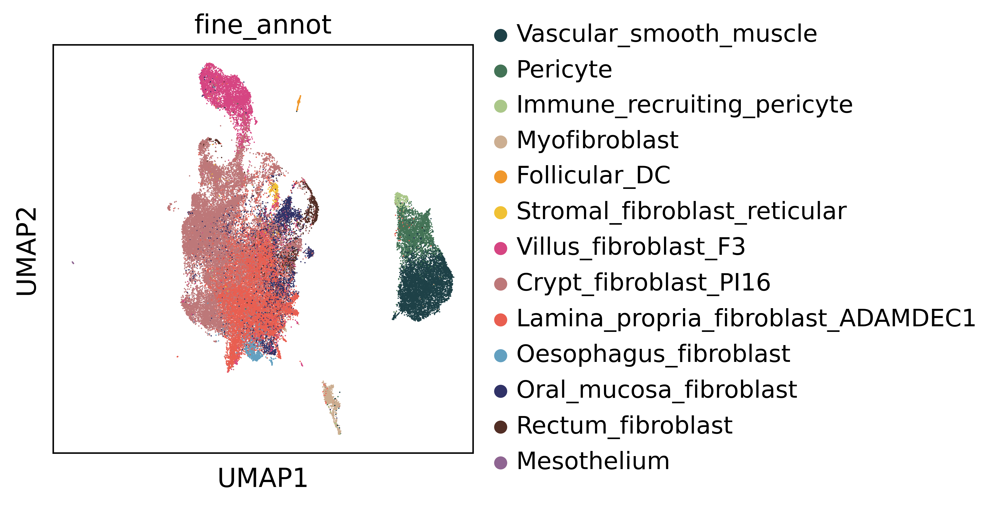

In [28]:
sc.pl.umap(adata,color='fine_annot',palette = ['#1E4147',#'Vascular_smooth_muscle',
                                                  '#437356',#'Pericyte',
                                                '#AAC789',#'Immune_recruiting_pericyte',
                                               '#CCAE91',#'Myofibroblast',                                           
                                                    '#f0982c',#'Follicular_DC',
                                               '#f0c134',#'Stromal_fibroblast_reticular',
                                                    '#d64582',#'Villus_fibroblast_F3'
                                               '#bd7879',#'Crypt_fibroblast_PI16', 
      
          
           '#e95e50',#'Lamina_propria_fibroblast_ADAMDEC1', 
           
           
           '#63A0C0',#'Oesophagus_fibroblast', 
           '#303267',#'Oral_mucosa_fibroblast', 
        
           '#522e25',#'Rectum_fibroblast',
                                               '#8F6592',#'Mesothelium', 
          
           
          
                                              ])

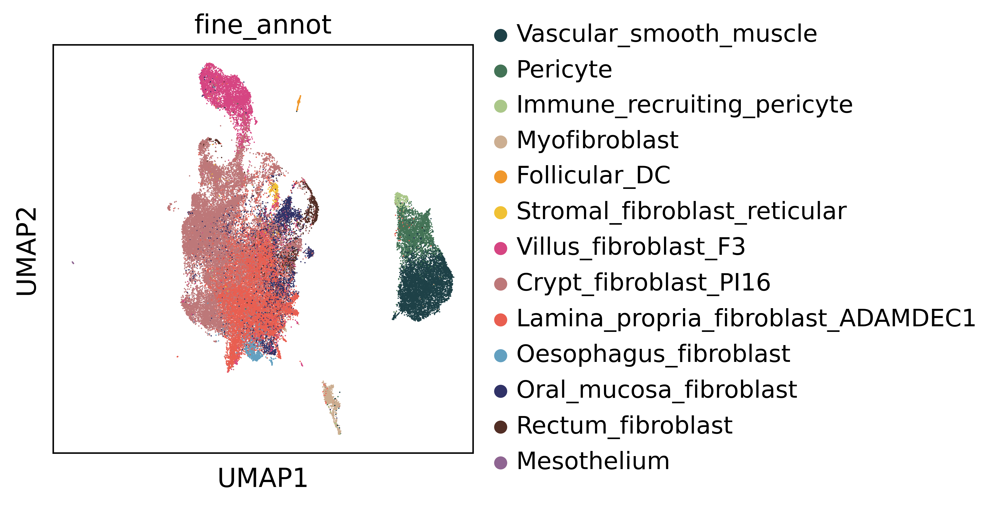

In [29]:
sc.pl.umap(adata,color='fine_annot',save='mes_AP.png')

<AxesSubplot: title={'center': 'fine_annot'}, xlabel='UMAP1', ylabel='UMAP2'>

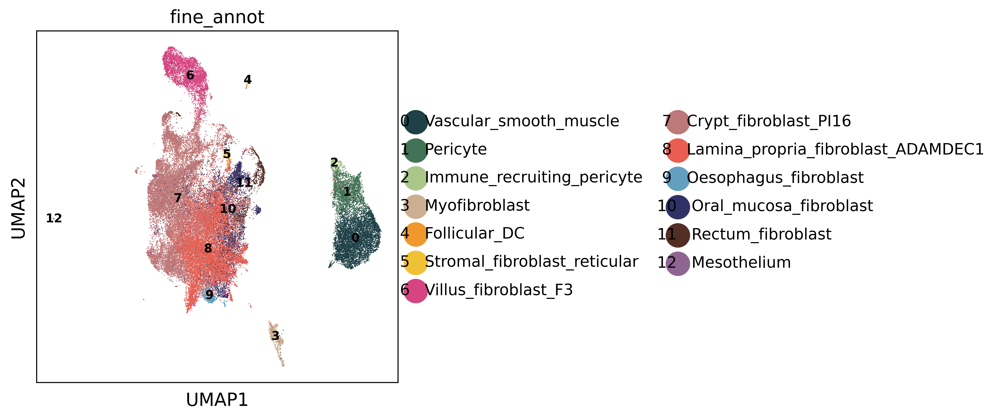

In [30]:
import sctk as sk
sk.plot_embedding(
    adata,
    basis="umap",
    groupby="fine_annot",
    figsize=(5, 5),
    save='figures/mes_AP_annot.png')